Make J-plot from GOES/SUVI images to track the speed of a solar feature

In [394]:
import warnings
warnings.filterwarnings('ignore')

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import AutoMinorLocator
from scipy.interpolate import UnivariateSpline
import astropy.io.fits as fits
import astropy.units as u
from astropy.coordinates import SkyCoord
import sunpy.map
from sunkit_instruments import suvi
from scipy import stats
import sunpy.sun.constants as const
from copy import deepcopy
from scipy.ndimage import gaussian_filter
from PIL import Image
import matplotlib.colors as colors
from astropy.visualization import ImageNormalize, LogStretch, LogStretch, PercentileInterval

plt.rcParams['figure.dpi'] = 100
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['savefig.facecolor'] = 'white'

data_dir = '/home/mnedal/data'

# J-map for the CME

In [338]:
def split_datetime(start=None, end=None):
    
    START_DATE, START_TIME = start.split('T')
    END_DATE, END_TIME = end.split('T')

    START_YEAR, START_MONTH, START_DAY = START_DATE.split('-')
    END_YEAR, END_MONTH, END_DAY = END_DATE.split('-')

    START_HOUR, START_MINUTE, START_SECOND = START_TIME.split(':')
    END_HOUR, END_MINUTE, END_SECOND = END_TIME.split(':')

    datetime_dict = {
        'start_year': START_YEAR,
        'start_month': START_MONTH,
        'start_day': START_DAY,
        'start_hour': START_HOUR,
        'start_minute': START_MINUTE,
        'start_second': START_SECOND,
        
        'end_year': END_YEAR,
        'end_month': END_MONTH,
        'end_day': END_DAY,
        'end_hour': END_HOUR,
        'end_minute': END_MINUTE,
        'end_second': END_SECOND
    }
    return datetime_dict



def load_suvi(start=None, end=None, channel=195):
    """
    * 9.4 nm (FeXVIII)
    * 13.1 nm (FeXXI)
    * 17.1 nm (FeIX/X)
    * 19.5 nm (FeXII)
    * 28.4 nm (FeXV)
    * 30.4 nm (HeII)
    """
    dt_dict = split_datetime(start=start, end=end)
    data_path = f"{data_dir}/SUVI/{dt_dict['start_year']}{dt_dict['start_month']}{dt_dict['start_day']}/{channel}A"
    root_filename = f"dr_suvi-l2-ci{channel}_g18_s"
    data = sorted(glob.glob(f"{data_path}/{root_filename}{dt_dict['start_year']}{dt_dict['start_month']}{dt_dict['start_day']}*.fits"))
    
    start_file_to_find = f"{data_path}/{root_filename}{dt_dict['start_year']}{dt_dict['start_month']}{dt_dict['start_day']}T{dt_dict['start_hour']}0000Z_e{dt_dict['start_year']}{dt_dict['start_month']}{dt_dict['start_day']}T{dt_dict['start_hour']}0400Z_v1-0-2.fits"
    end_file_to_find   = f"{data_path}/{root_filename}{dt_dict['end_year']}{dt_dict['end_month']}{dt_dict['end_day']}T{dt_dict['end_hour']}2800Z_e{dt_dict['end_year']}{dt_dict['end_month']}{dt_dict['end_day']}T{dt_dict['end_hour']}3200Z_v1-0-2.fits"
    
    idx1 = data.index(start_file_to_find)
    idx2 = data.index(end_file_to_find)
    
    chosen_files = data[idx1:idx2]
    
    map_objects = []
    for i, file in enumerate(chosen_files):
        m = suvi.files_to_map(file, despike_l1b=True)
        min_range = 0
        if channel == 94:
            max_range = 20
        elif channel == 171:
            max_range = 20
        elif channel == 131:
            max_range = 20
        elif channel == 195:
            max_range = 50
        elif channel == 284:
            max_range = 50
        elif channel == 304:
            max_range = 100
        
        m.plot_settings['norm'] = ImageNormalize(vmin=min_range, vmax=max_range, stretch=LogStretch())
        map_objects.append(m)
        print(f'SUVI image {i} is done')
    return map_objects



def plot_line(angle_deg=None, length=None, map_obj=None):
    """
    Plot a straight line at an angle in degrees from the solar West.
    """
    angle_rad = np.deg2rad(angle_deg)

    # Define the length of the line (in arcseconds)
    line_length = length * u.arcsec

    # Define the center point of the line (e.g., the center of the map)
    center = map_obj.center

    # Calculate the start and end points of the line
    start_point = SkyCoord(center.Tx, center.Ty, frame=map_obj.coordinate_frame)

    end_point = SkyCoord(center.Tx + line_length * np.cos(angle_rad),
                        center.Ty + line_length * np.sin(angle_rad),
                        frame=map_obj.coordinate_frame)
    
    line = SkyCoord([start_point, end_point])
    return line



def generate_centered_list(center, difference, num_elements):
    """
    Generate a list of numbers centered around a given number with a specified difference
    between consecutive numbers.

    Parameters:
    center (int): The central number around which the list is generated.
    difference (int): The difference between consecutive numbers in the list.
    num_elements (int): The number of elements before and after the central number.

    Returns:
    list: A list of numbers centered around the specified central number.
    """
    return [center + difference * i for i in range(-num_elements, num_elements + 1)]



def remove_redundant_maps(maps):
    """
    Remove redundant SunPy maps, keeping only one map per unique timestamp.

    Parameters:
    maps (list): List of SunPy Map objects. Each map is expected to have a 'date-obs' 
                 key in its metadata that provides the observation timestamp.

    Returns:
    list: A list of unique SunPy Map objects, one per unique timestamp.
    
    Example:
    >>> unique_maps = remove_redundant_maps(list_of_sunpy_maps)
    """
    unique_maps = {}
    for m in maps:
        timestamp = m.latex_name
        if timestamp not in unique_maps:
            unique_maps[timestamp] = m
    return list(unique_maps.values())



# make running-ratio images
def apply_runratio(maps):
    """
    Apply running-ratio image technique on EUV images.
    See: https://iopscience.iop.org/article/10.1088/0004-637X/750/2/134/pdf
        Inputs: list of EUV sunpy maps.
        Output: sequence of run-ratio sunpy maps.
    """
    runratio = [m / prev_m.quantity for m, prev_m in zip(maps[1:], maps[:-1])]
    m_seq_runratio = sunpy.map.Map(runratio, sequence=True)
    
    for m in m_seq_runratio:
        m.data[np.isnan(m.data)] = 1
        m.plot_settings['norm'] = colors.Normalize(vmin=0, vmax=2)
        m.plot_settings['cmap'] = 'seismic'
    
    return m_seq_runratio



def enhance_contrast(image, vmin, vmax):
    """
    Enhance contrast by clipping and normalization.
    """
    image_clipped = np.clip(image, vmin, vmax)
    image_normalized = (image_clipped - vmin) / (vmax - vmin)
    return image_normalized



def calculate_percentiles(image, lower_percentile=3, upper_percentile=97):
    """
    Calculate vmin and vmax based on the 1st and 99th percentiles.
    """
    vmin = np.percentile(image, lower_percentile)
    vmax = np.percentile(image, upper_percentile)
    return vmin, vmax



def round_obstime(time=None):
    """
    Round the observation time to put it in the image title.
    Input : str, time (HH:MM:SS.sss)
    Output: str, datetime (YYYY-mm-DD HH:MM:SS)
    """
    from datetime import datetime, timedelta

    original_time_str = time

    # Convert the original time string to a datetime object
    original_time = datetime.strptime(original_time_str, '%H:%M:%S.%f')

    # Round the time to the nearest second
    rounded_time = original_time + timedelta(seconds=round(original_time.microsecond / 1e6))

    # Format the rounded time as 'HH:MM:SS'
    rounded_time_str = rounded_time.strftime('%H:%M:%S')
    
    return rounded_time_str

In [340]:
suvi_171_map_objects = load_suvi(start='2024-05-14T17:00:00', end='2024-05-14T18:00:00', channel=171)
suvi_195_map_objects = load_suvi(start='2024-05-14T17:00:00', end='2024-05-14T18:00:00', channel=195)
suvi_284_map_objects = load_suvi(start='2024-05-14T17:00:00', end='2024-05-14T18:00:00', channel=284)

SUVI image 0 is done
SUVI image 1 is done
SUVI image 2 is done
SUVI image 3 is done
SUVI image 4 is done
SUVI image 5 is done
SUVI image 6 is done
SUVI image 7 is done
SUVI image 8 is done
SUVI image 9 is done
SUVI image 10 is done
SUVI image 11 is done
SUVI image 12 is done
SUVI image 13 is done
SUVI image 14 is done
SUVI image 15 is done
SUVI image 16 is done
SUVI image 17 is done
SUVI image 18 is done
SUVI image 19 is done
SUVI image 20 is done
SUVI image 21 is done
SUVI image 0 is done
SUVI image 1 is done
SUVI image 2 is done
SUVI image 3 is done
SUVI image 4 is done
SUVI image 5 is done
SUVI image 6 is done
SUVI image 7 is done
SUVI image 8 is done
SUVI image 9 is done
SUVI image 10 is done
SUVI image 11 is done
SUVI image 12 is done
SUVI image 13 is done
SUVI image 14 is done
SUVI image 15 is done
SUVI image 16 is done
SUVI image 17 is done
SUVI image 18 is done
SUVI image 19 is done
SUVI image 20 is done
SUVI image 21 is done
SUVI image 0 is done
SUVI image 1 is done
SUVI image

In [341]:
print(len(suvi_171_map_objects), len(suvi_195_map_objects), len(suvi_284_map_objects))

22 22 22


INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


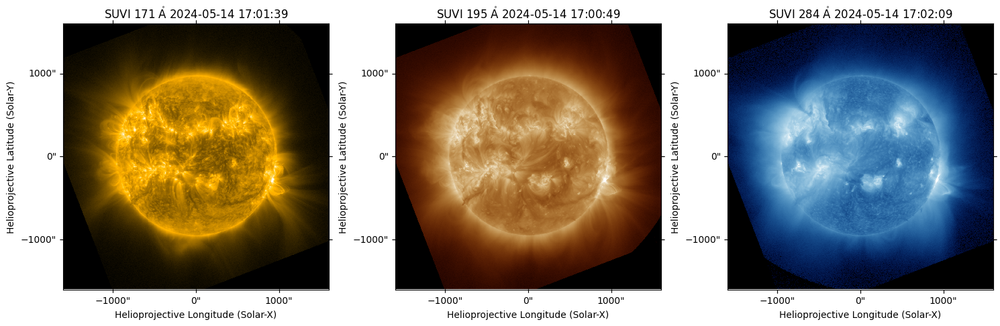

In [342]:
index = 0

fig = plt.figure(figsize=[15,5])

ax = fig.add_subplot(131, projection=suvi_171_map_objects[index])
suvi_171_map_objects[index].plot(axes=ax)
ax.grid(False)

ax = fig.add_subplot(132, projection=suvi_195_map_objects[index])
suvi_195_map_objects[index].plot(axes=ax)
ax.grid(False)

ax = fig.add_subplot(133, projection=suvi_284_map_objects[index])
suvi_284_map_objects[index].plot(axes=ax)
ax.grid(False)

fig.tight_layout()
plt.show()

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


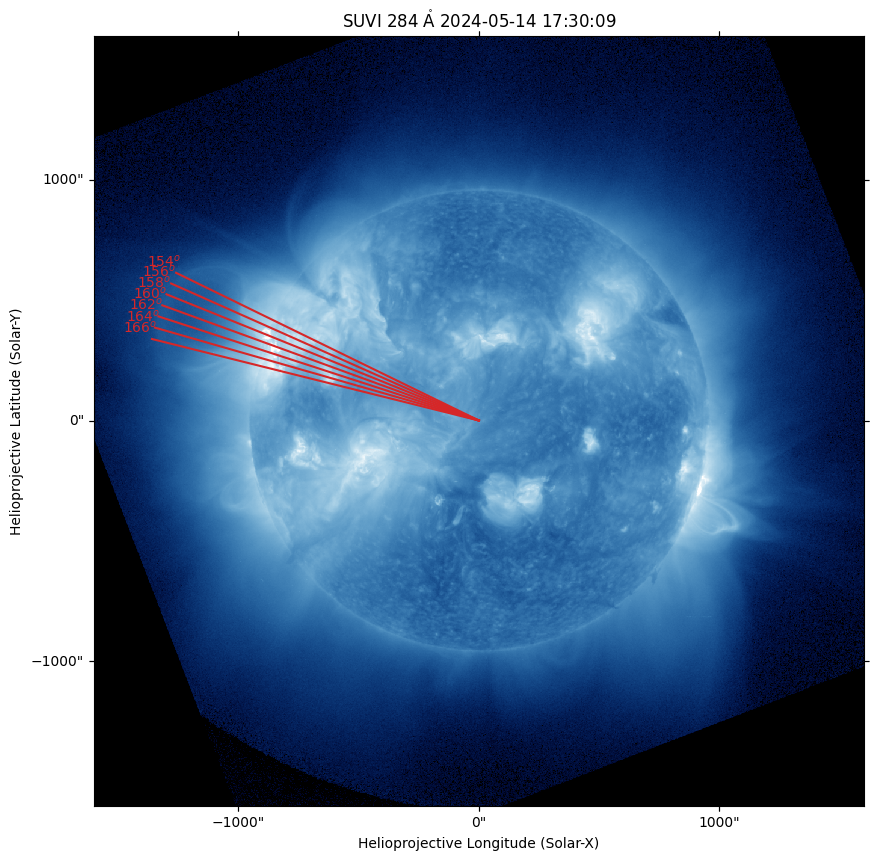

In [343]:
# Plot the map
m = suvi_284_map_objects[7]

fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(projection=m)
m.plot(axes=ax)
ax.grid(False)

# Plot the slits
# centered_list = generate_centered_list(161, 4, 3)
centered_list = generate_centered_list(160, 2, 3)

for angle in centered_list:
    line = plot_line(angle_deg=angle, length=1400, map_obj=m)
    ax.plot_coord(line, color='tab:red')
    
    # Plot the number at the end of the line
    # Convert SkyCoord to pixel coordinates for plotting text
    line_lon, line_lat = line.Tx, line.Ty
    end_point_pixel = m.world_to_pixel(SkyCoord(line_lon[1], line_lat[1], frame=m.coordinate_frame))
    
    # Display the number at the end point
    ax.text(end_point_pixel.x.value - 20, end_point_pixel.y.value + 20, f'{angle}$^o$',
            color='tab:red', fontsize=10, ha='center', va='center')

plt.show()

### Apply running ratio

In [344]:
print(len(suvi_171_map_objects), len(suvi_195_map_objects), len(suvi_284_map_objects))

22 22 22


In [345]:
clean_maps_171A = remove_redundant_maps(suvi_171_map_objects)
clean_maps_195A = remove_redundant_maps(suvi_195_map_objects)
clean_maps_284A = remove_redundant_maps(suvi_284_map_objects)

print(len(clean_maps_171A), len(clean_maps_195A), len(clean_maps_284A))

22 22 22


In [346]:
# make run-diff maps
m_seq_runratio_171A = apply_runratio(clean_maps_171A)
m_seq_runratio_195A = apply_runratio(clean_maps_195A)
m_seq_runratio_284A = apply_runratio(clean_maps_284A)

print(len(m_seq_runratio_171A), len(m_seq_runratio_195A), len(m_seq_runratio_284A))

21 21 21


In [13]:
rgb_image = np.stack([m_seq_runratio_171A[6].data,
                      m_seq_runratio_195A[6].data,
                      m_seq_runratio_284A[6].data],
                     axis=-1)

# Enhance contrast for each channel
rgb_image_enhanced = np.zeros_like(rgb_image)
for i in range(3):  # Process each channel independently
    vmin, vmax = calculate_percentiles(rgb_image[..., i])
    rgb_image_enhanced[..., i] = enhance_contrast(rgb_image[..., i], vmin, vmax)

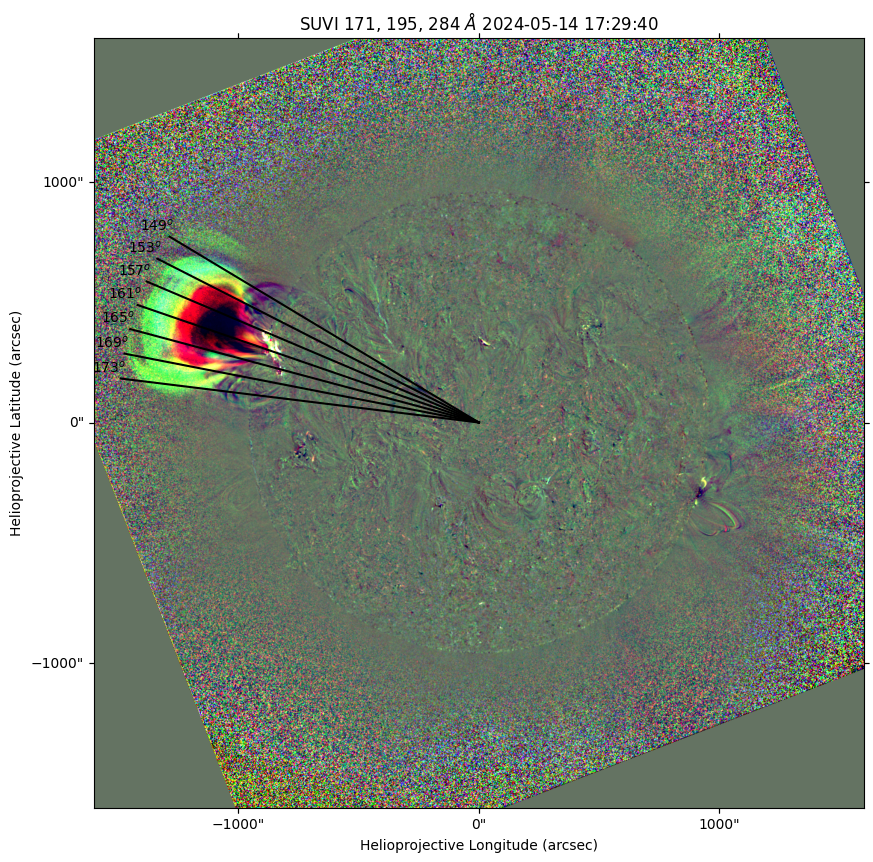

In [22]:
m = m_seq_runratio_171A[6]

fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111, projection=m)
ax.imshow(rgb_image_enhanced, vmin=0, vmax=1)

date_str = str(m.date).split('T')[0]
rounded_time_str = round_obstime(time=str(m.date).split('T')[1])
ax.set_title(f'SUVI 171, 195, 284 $\AA$ {date_str} {rounded_time_str}')
ax.set_xlabel('Helioprojective Longitude (arcsec)')
ax.set_ylabel('Helioprojective Latitude (arcsec)')

# Plot the slits
centered_list = generate_centered_list(161, 4, 3)

for angle in centered_list:
    line = plot_line(angle_deg=angle, length=1500, map_obj=m)
    ax.plot_coord(line, color='black')
    
    # Plot the number at the end of the line
    # Convert SkyCoord to pixel coordinates for plotting text
    line_lon, line_lat = line.Tx, line.Ty
    end_point_pixel = m.world_to_pixel(SkyCoord(line_lon[1], line_lat[1], frame=m.coordinate_frame))
    
    # Display the number at the end point
    ax.text(end_point_pixel.x.value - 20, end_point_pixel.y.value + 20, f'{angle}$^o$',
            color='black', fontsize=10, ha='center', va='center')

plt.show()

In [36]:
# Convert the 3D array to a 2D array by averaging the channels
array_2d = np.mean(rgb_image_enhanced, axis=2)
m = sunpy.map.Map(array_2d, m.meta)

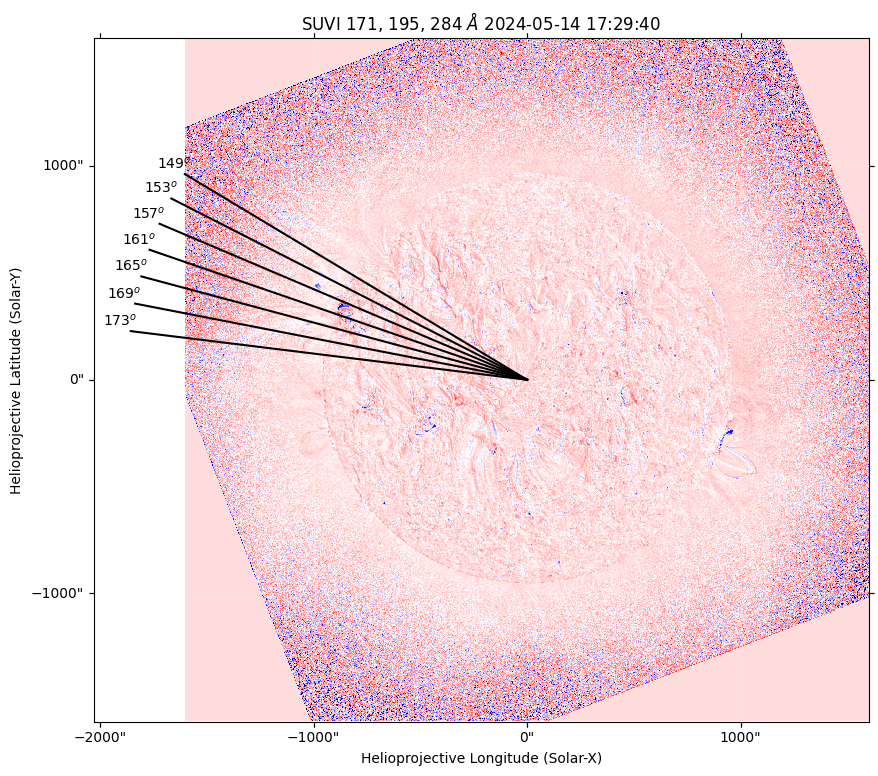

In [42]:
fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111, projection=m)
m.plot(axes=ax, cmap='seismic', vmin=0, vmax=5)
ax.set_title(f'SUVI 171, 195, 284 $\AA$ {date_str} {rounded_time_str}')

# Plot the slits
centered_list = generate_centered_list(161, 4, 3)

for angle in centered_list:
    line = plot_line(angle_deg=angle, length=1870, map_obj=m)
    ax.plot_coord(line, color='black')
    
    # Plot the number at the end of the line
    # Convert SkyCoord to pixel coordinates for plotting text
    line_lon, line_lat = line.Tx, line.Ty
    end_point_pixel = m.world_to_pixel(SkyCoord(line_lon[1], line_lat[1], frame=m.coordinate_frame))
    
    # Display the number at the end point
    ax.text(end_point_pixel.x.value - 20, end_point_pixel.y.value + 20, f'{angle}$^o$',
            color='black', fontsize=10, ha='center', va='center')

plt.show()

### Loop over all images

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


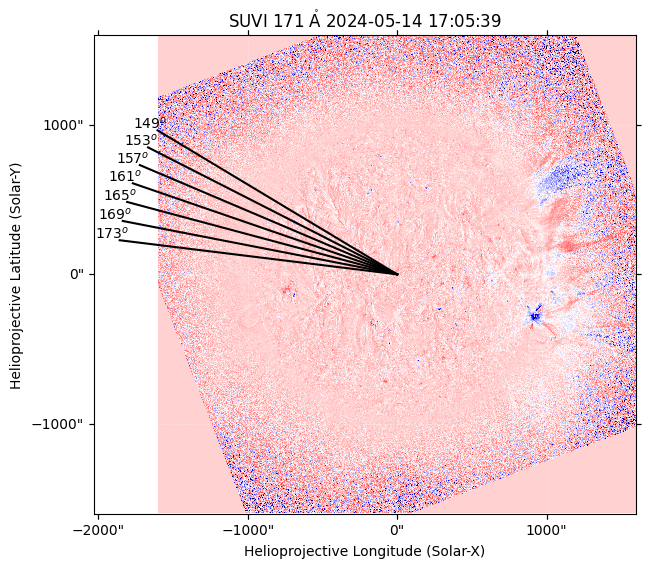

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


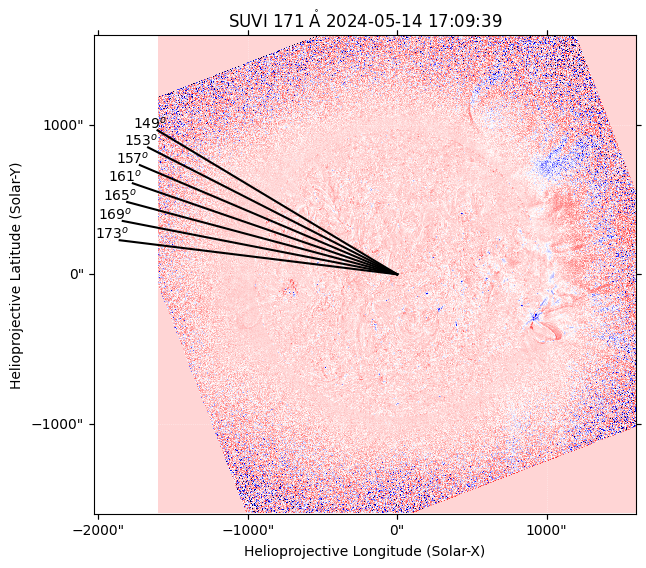

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


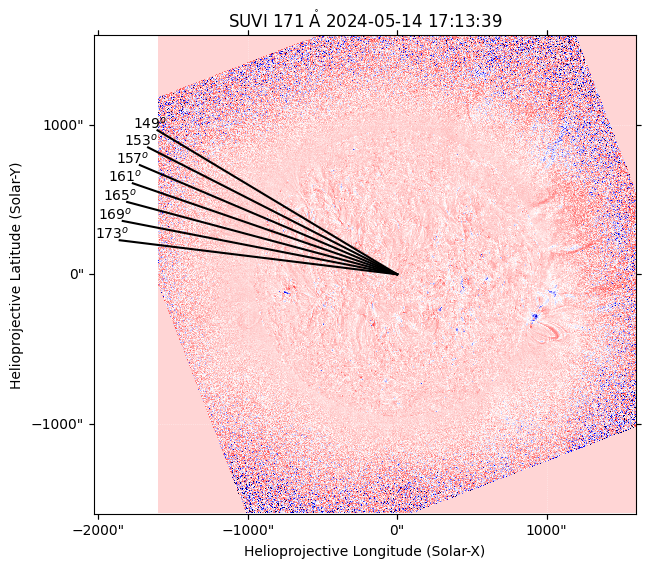

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


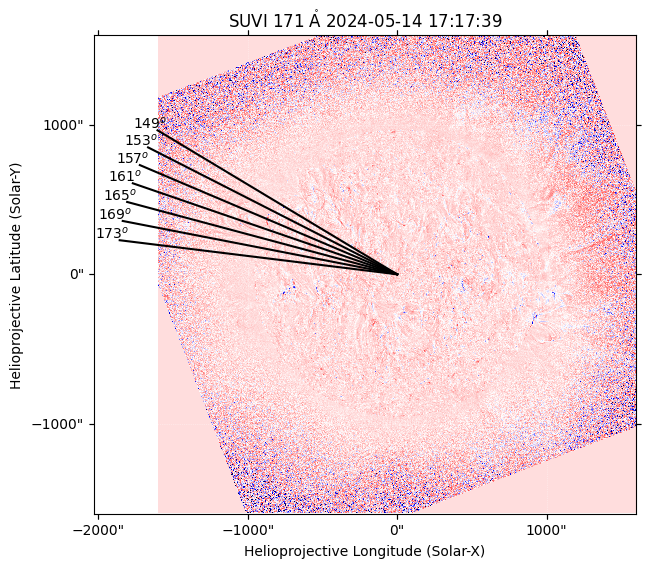

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


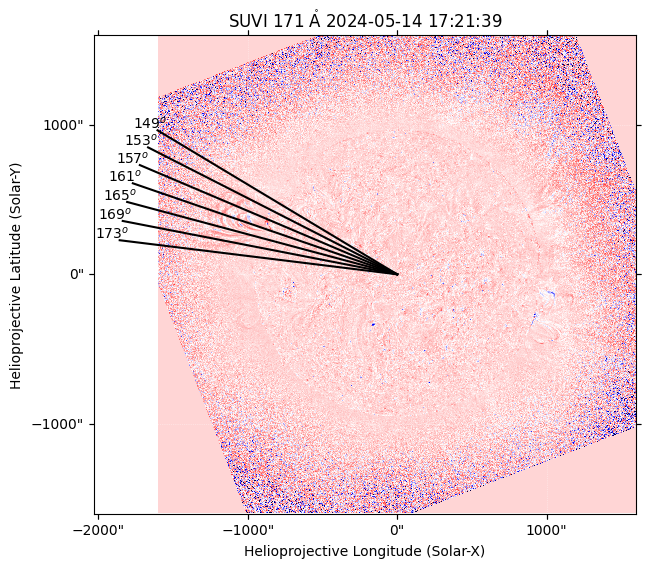

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


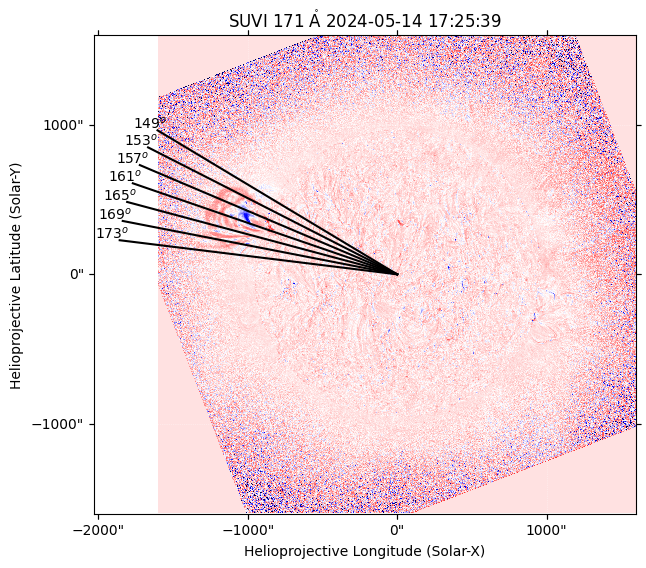

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


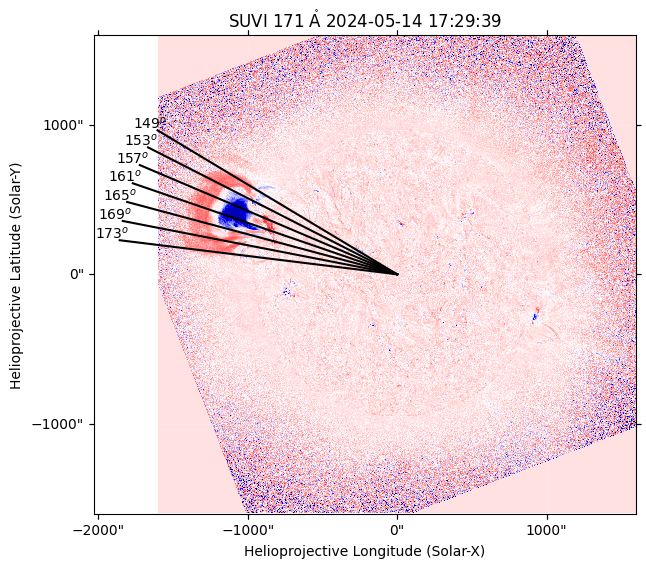

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


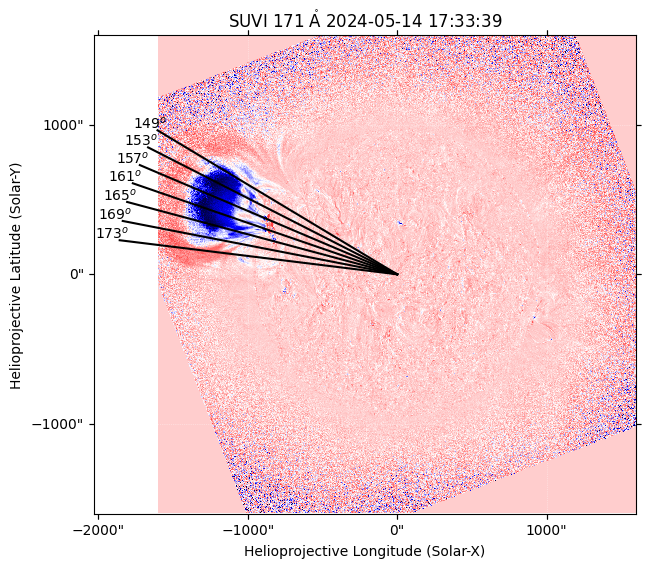

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


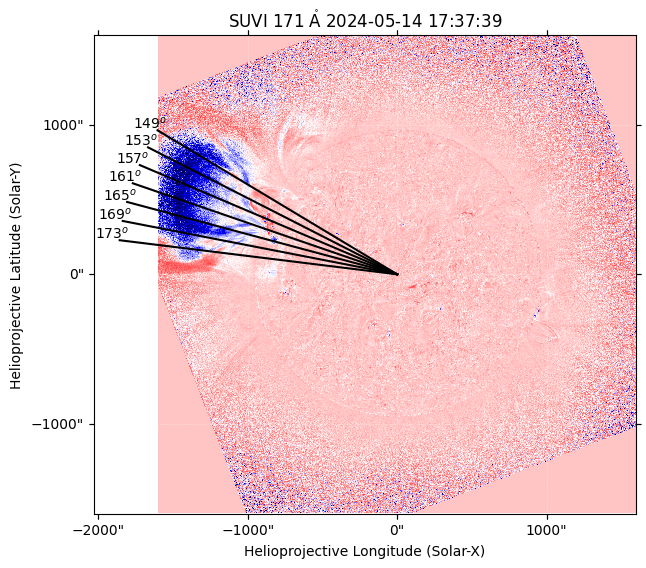

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


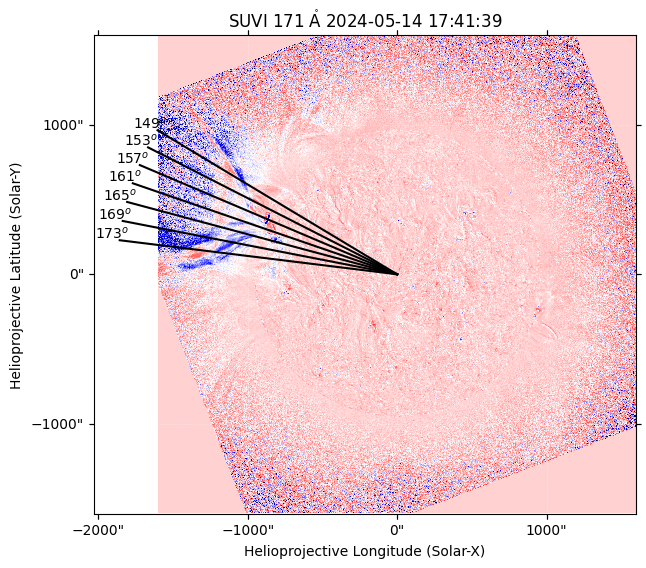

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


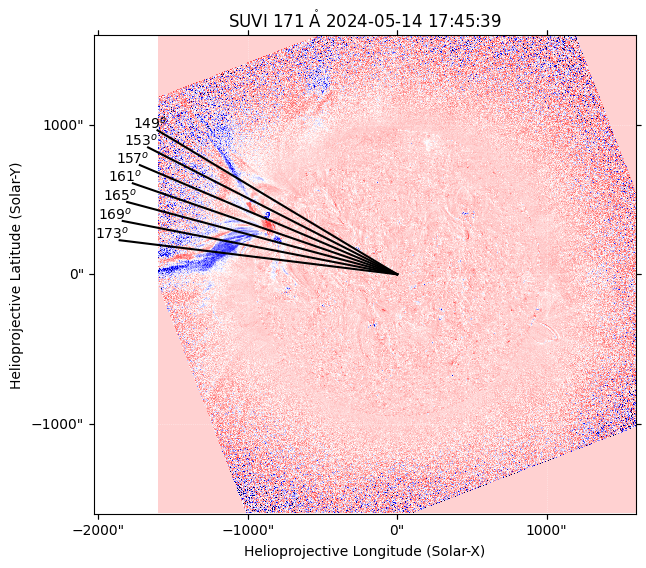

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


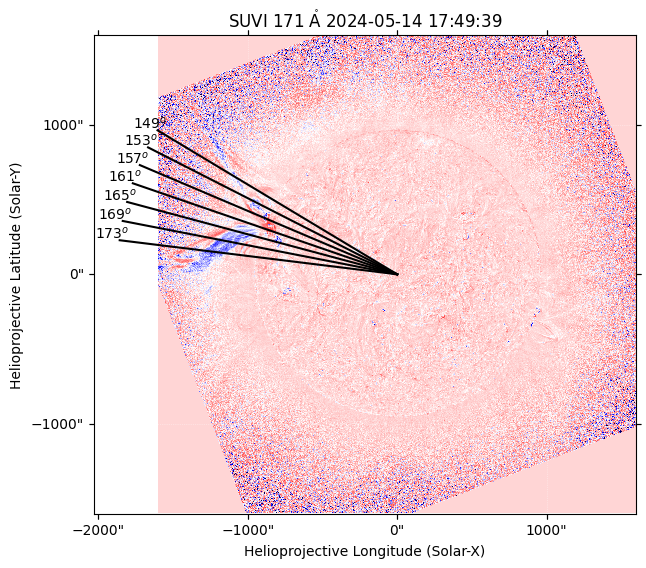

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


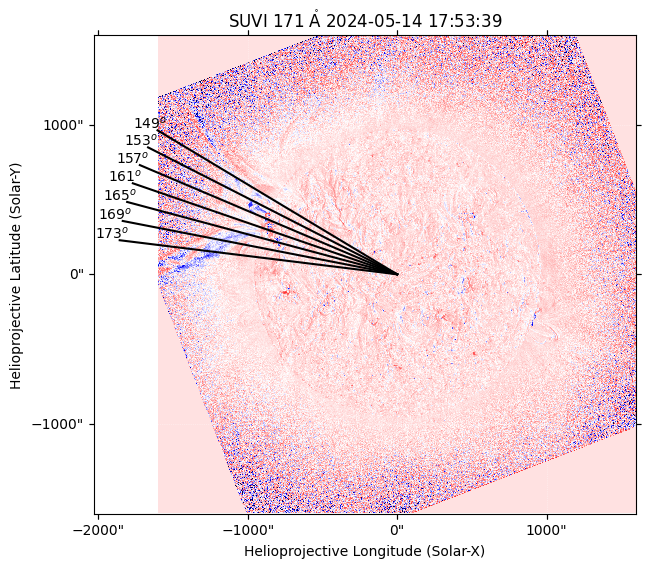

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


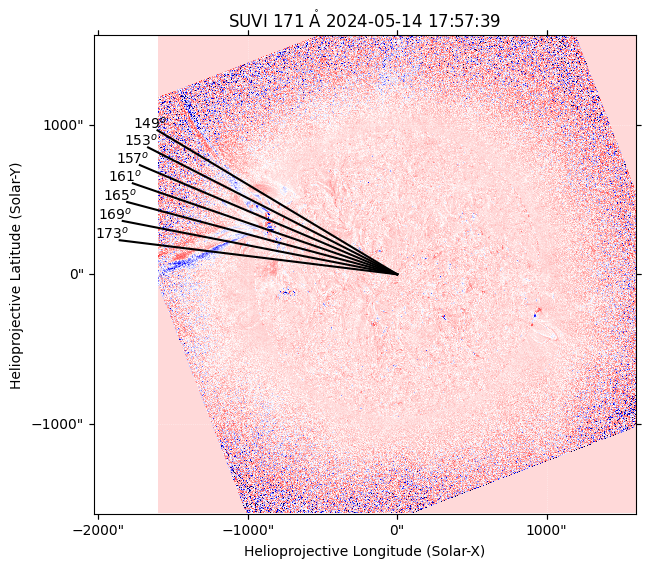

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


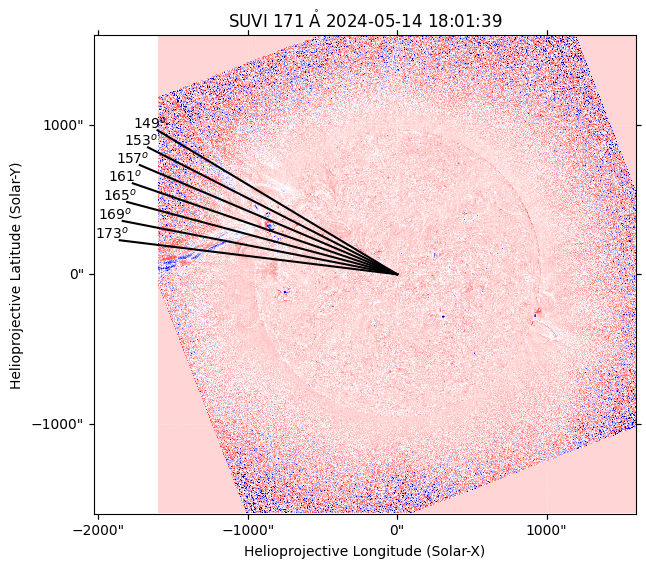

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


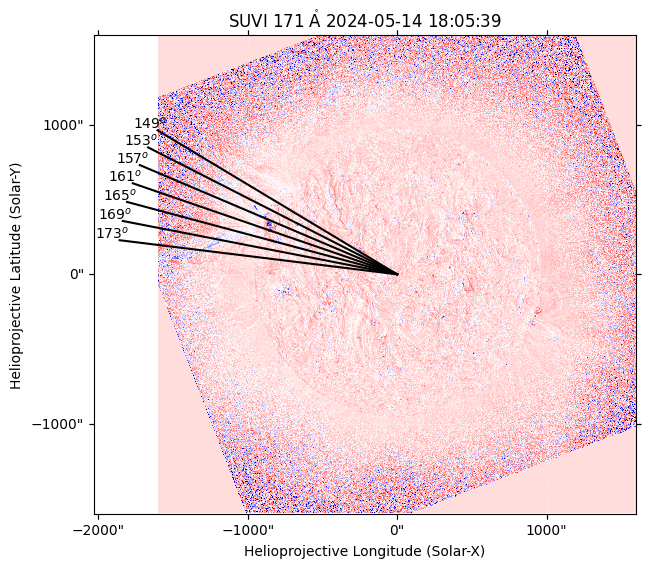

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


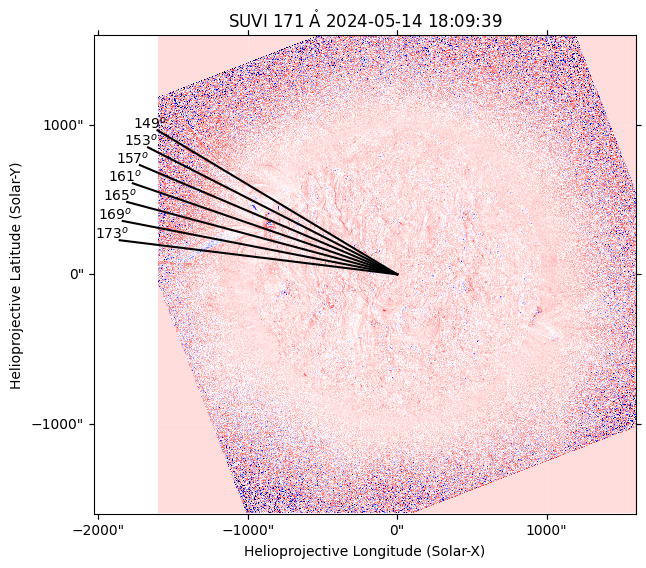

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


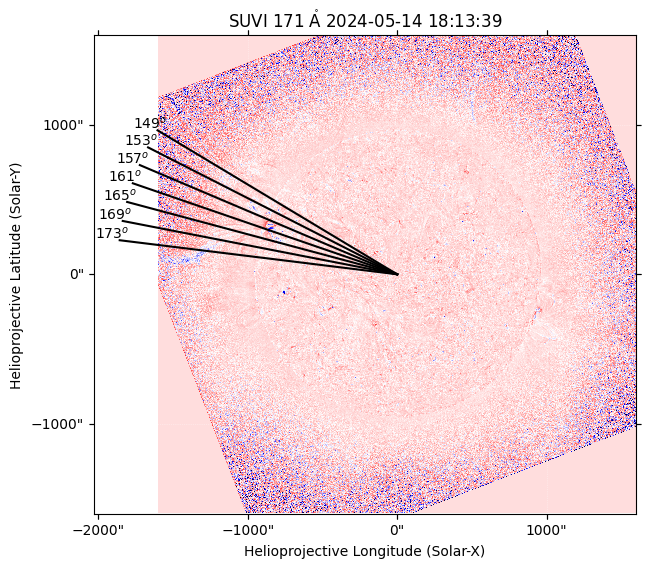

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


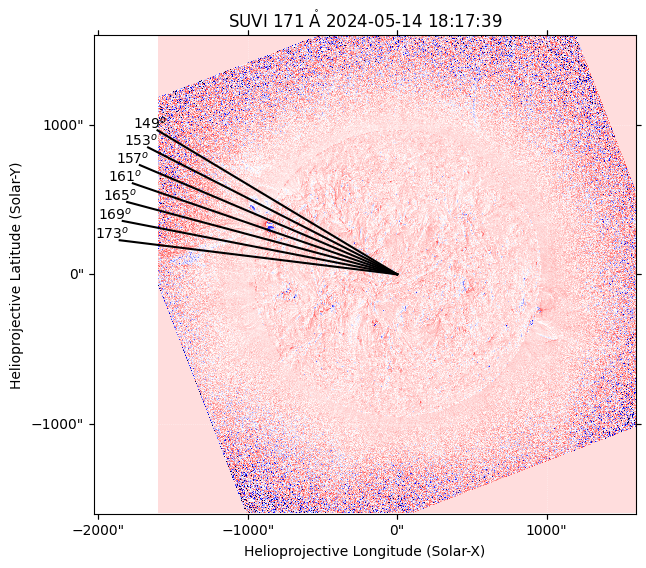

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


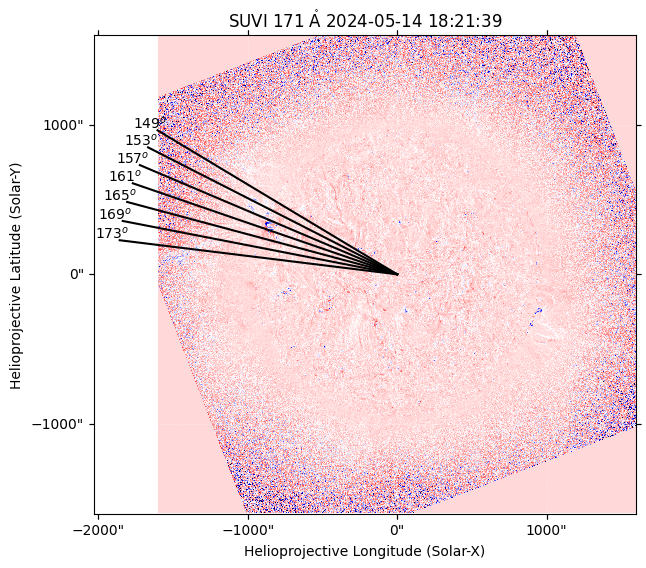

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


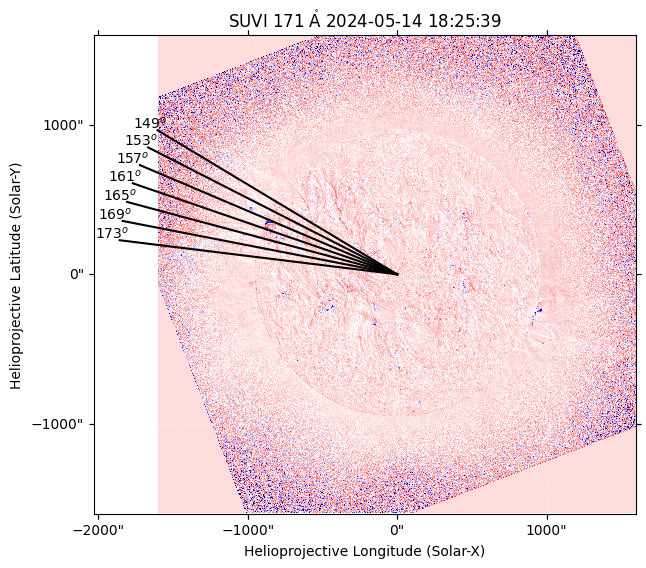

In [43]:
suvi_rgb = []

for idx, _ in enumerate(m_seq_runratio_171A):
    
    rgb_image = np.stack([m_seq_runratio_171A[idx].data,
                          m_seq_runratio_195A[idx].data,
                          m_seq_runratio_284A[idx].data],
                         axis=-1)
    
    # Enhance contrast for each channel
    rgb_image_enhanced = np.zeros_like(rgb_image)
    for i in range(3):  # Process each channel independently
        vmin, vmax = calculate_percentiles(rgb_image[..., i])
        rgb_image_enhanced[..., i] = enhance_contrast(rgb_image[..., i], vmin, vmax)
    
    # Convert the 3D array to a 2D array by averaging the channels
    array_2d = np.mean(rgb_image_enhanced, axis=2)
    m = sunpy.map.Map(array_2d, m_seq_runratio_171A[idx].meta)
    suvi_rgb.append(m)
    
    fig = plt.figure(figsize=[7,7])
    ax = fig.add_subplot(111, projection=m)
    m.plot(axes=ax, cmap='seismic', vmin=0, vmax=5)
    
    # Plot the slits
    centered_list = generate_centered_list(161, 4, 3)

    for angle in centered_list:
        line = plot_line(angle_deg=angle, length=1870, map_obj=m)
        ax.plot_coord(line, color='black')

        # Plot the number at the end of the line
        # Convert SkyCoord to pixel coordinates for plotting text
        line_lon, line_lat = line.Tx, line.Ty
        end_point_pixel = m.world_to_pixel(SkyCoord(line_lon[1], line_lat[1], frame=m.coordinate_frame))

        # Display the number at the end point
        ax.text(end_point_pixel.x.value - 20, end_point_pixel.y.value + 20, f'{angle}$^o$',
                color='black', fontsize=10, ha='center', va='center')
    
    plt.show()

In [44]:
print(len(suvi_rgb))

21


Working on map 0 ..


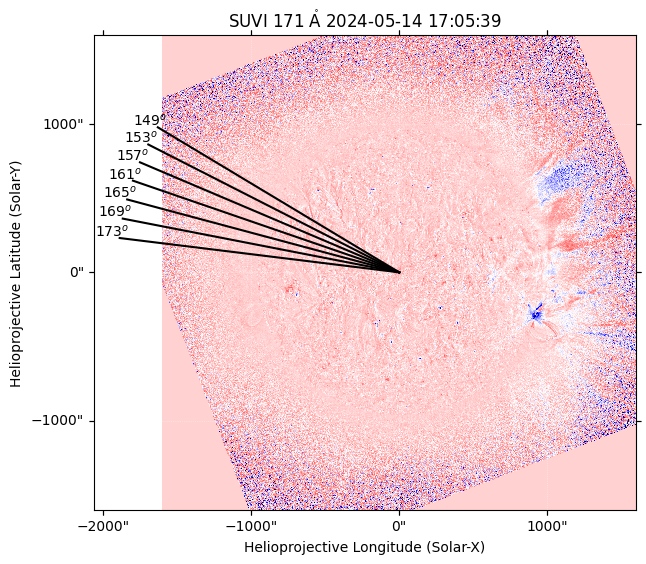

Working on map 1 ..


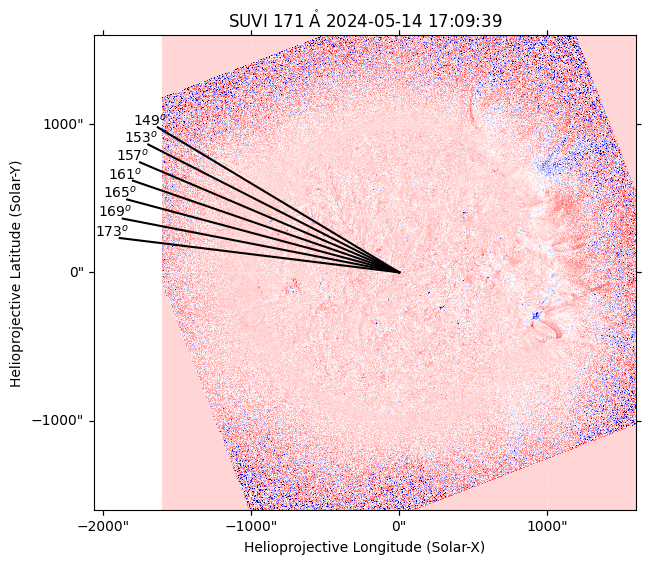

Working on map 2 ..


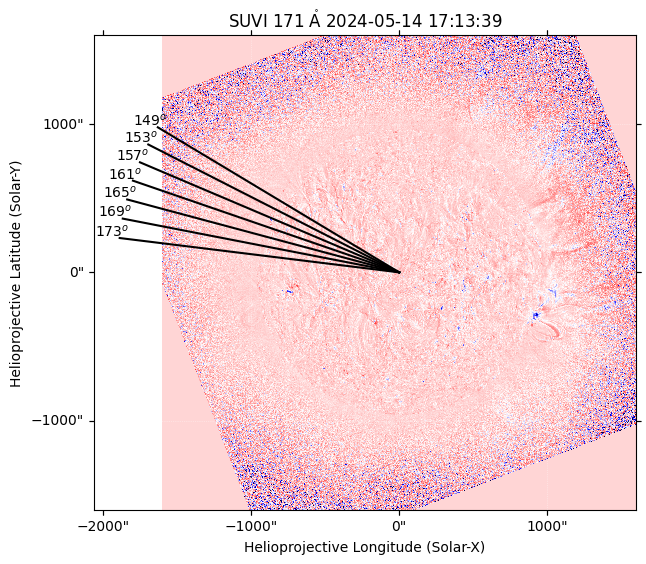

Working on map 3 ..


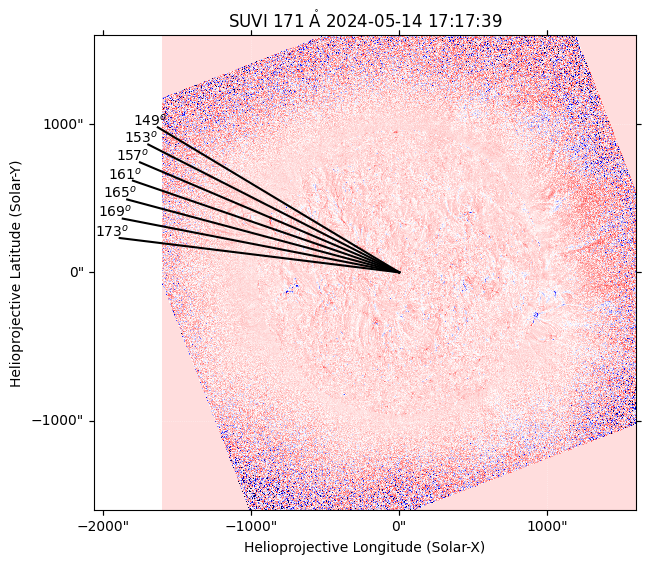

Working on map 4 ..


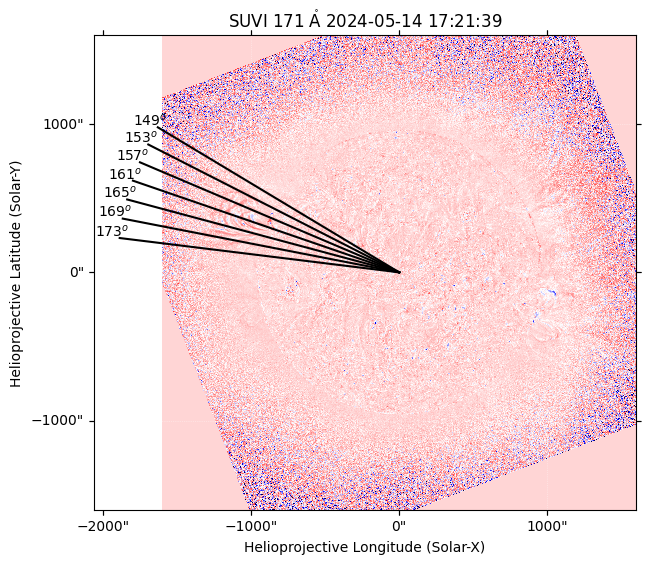

Working on map 5 ..


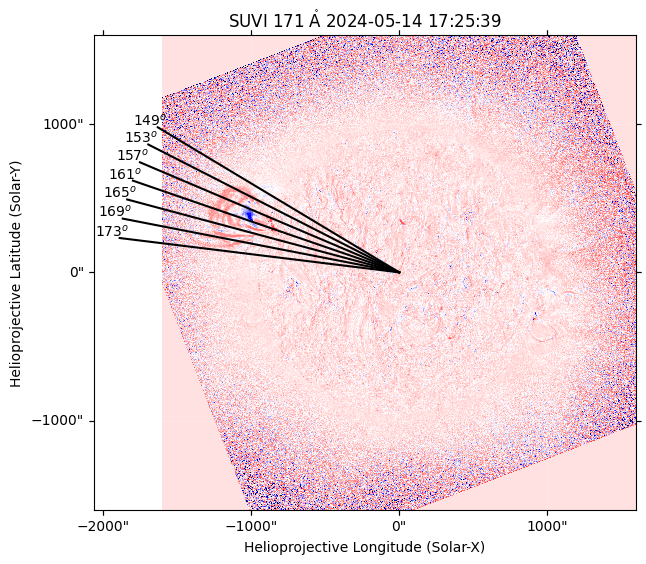

Working on map 6 ..


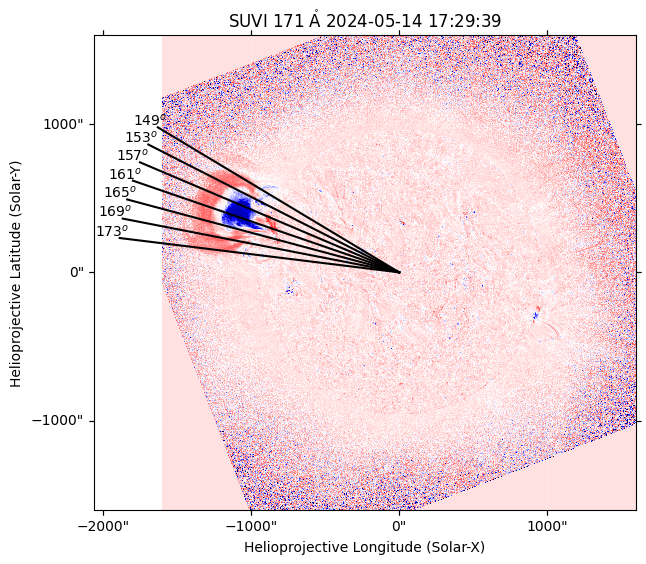

Working on map 7 ..


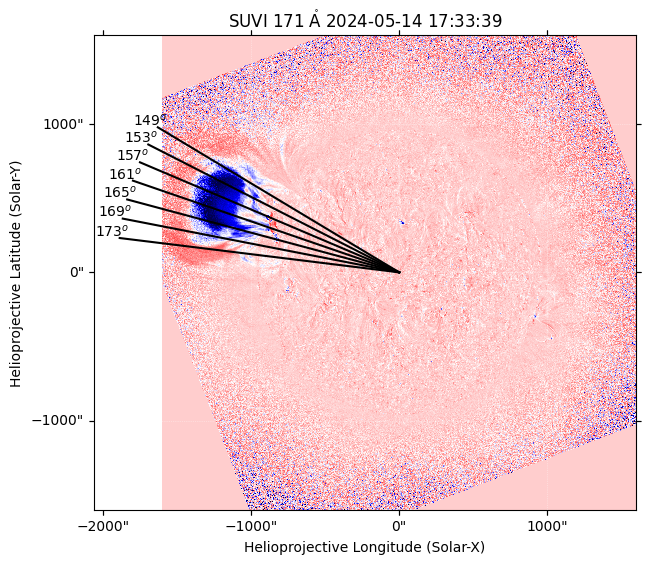

Working on map 8 ..


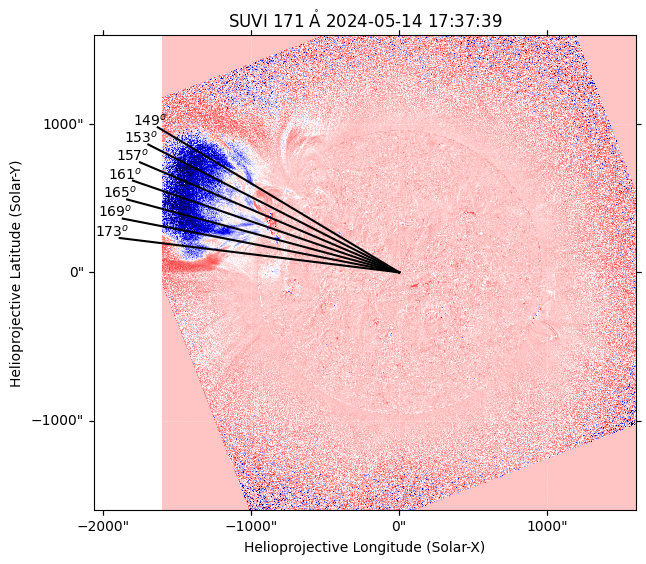

Working on map 9 ..


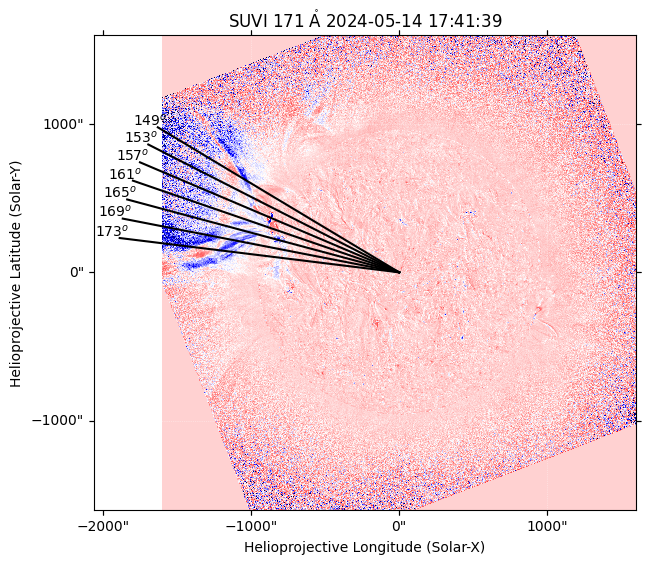

Working on map 10 ..


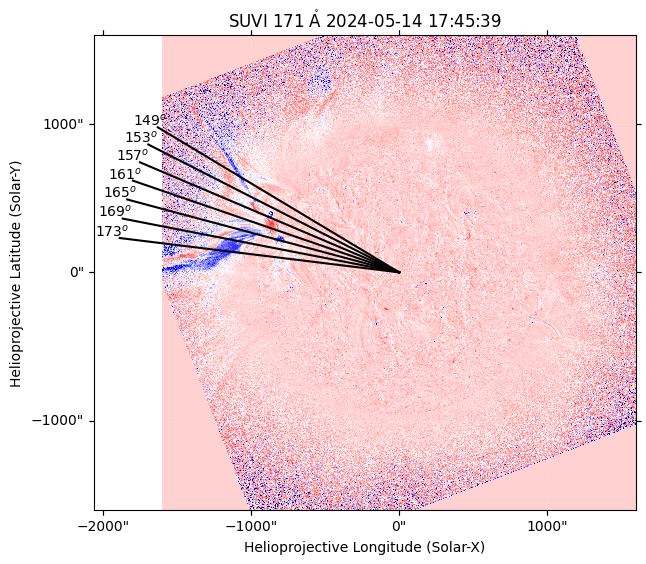

Working on map 11 ..


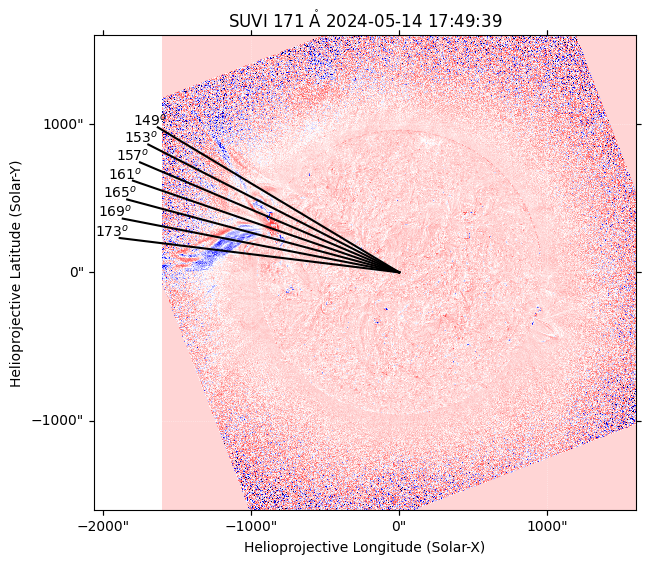

Working on map 12 ..


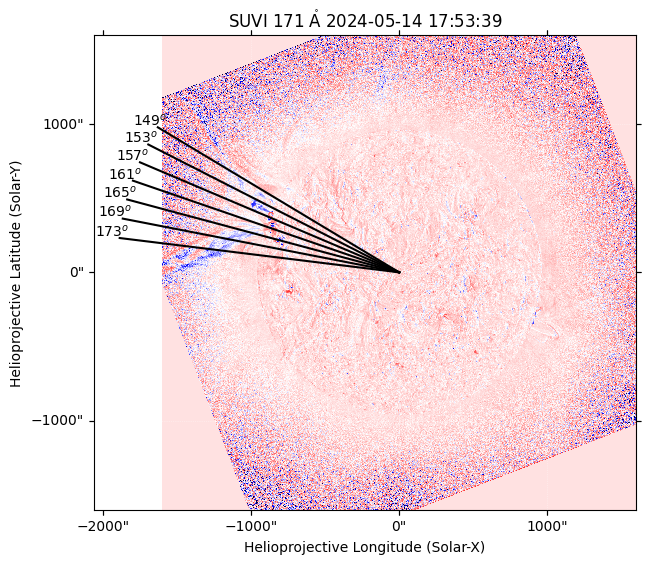

Working on map 13 ..


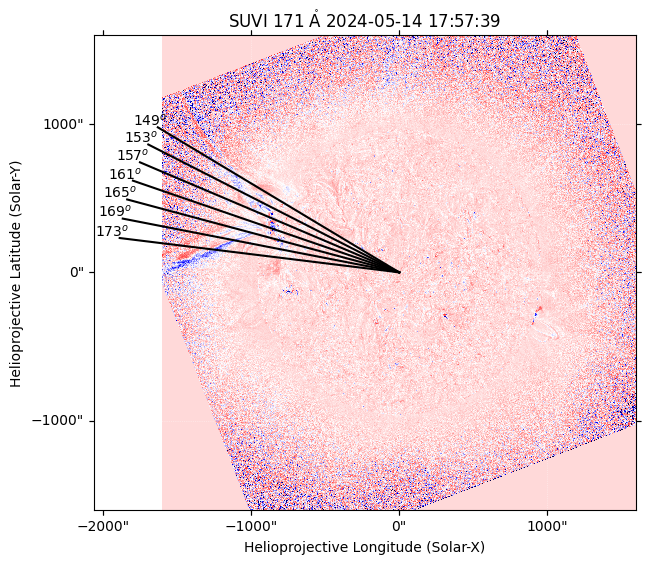

Working on map 14 ..


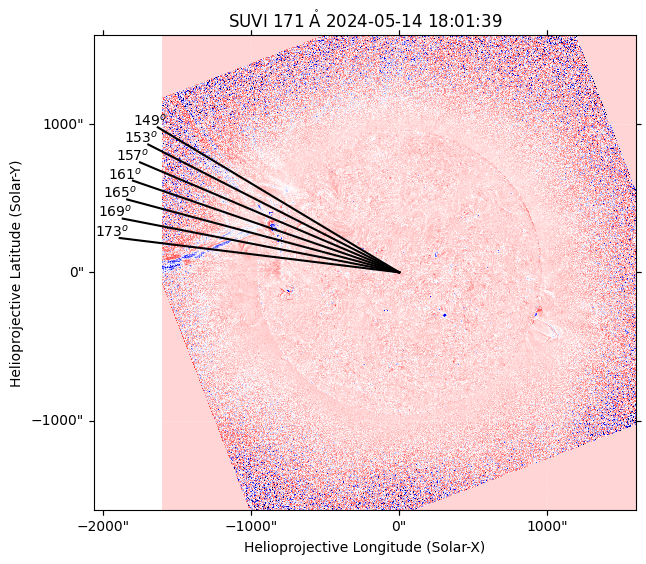

Working on map 15 ..


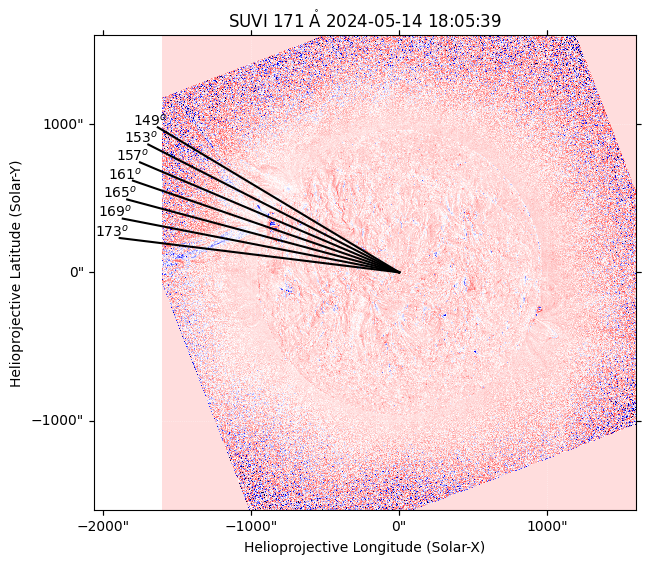

Working on map 16 ..


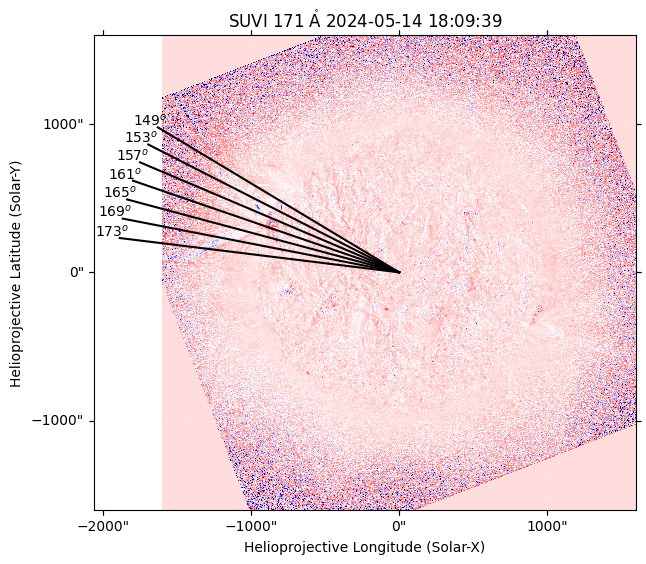

Working on map 17 ..


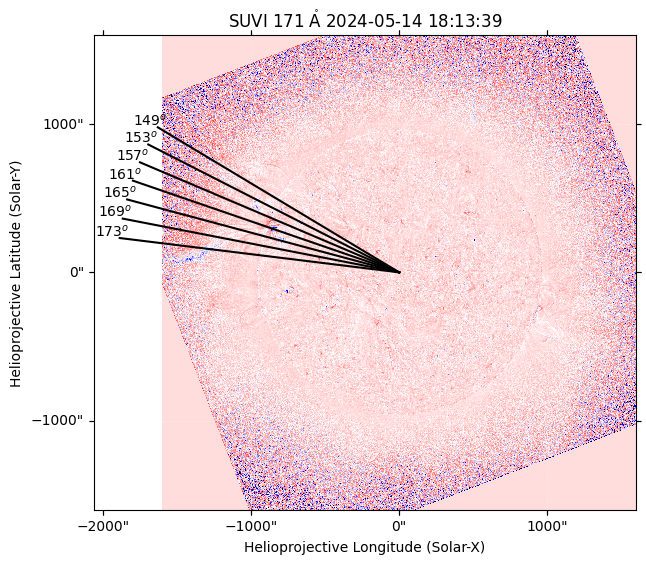

Working on map 18 ..


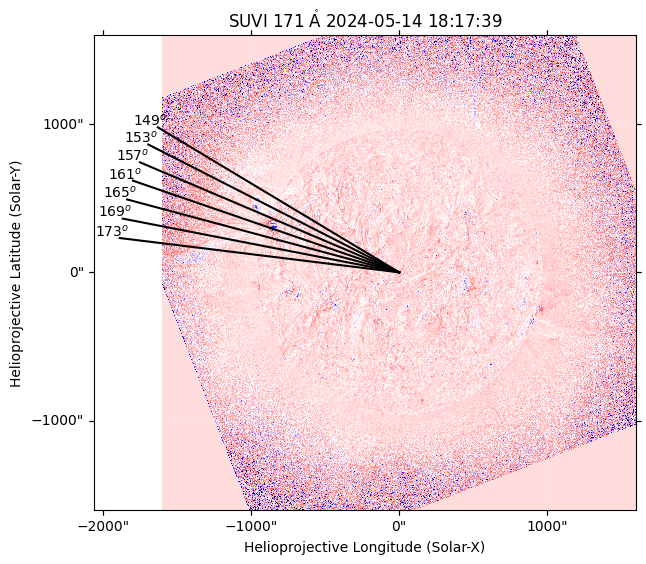

Working on map 19 ..


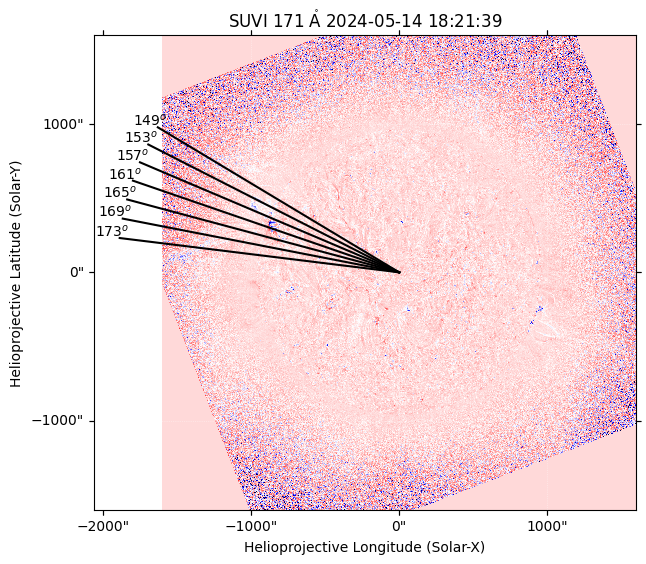

Working on map 20 ..


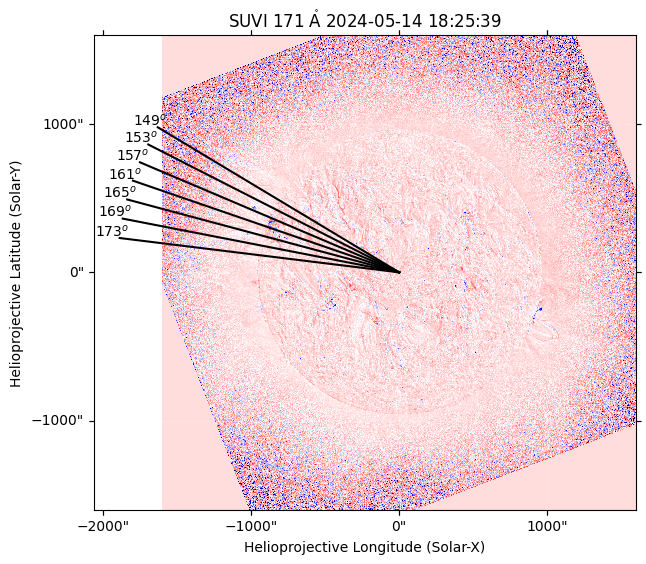

In [139]:
# Create a dictionary to hold the lists of lists
intensity_dict = {}
distances_dict = {}
output_obj = {}

# Initialize each key with an empty list
for value in centered_list:
    intensity_dict[f'intensity_{value}deg'] = []
    distances_dict[f'distances_{value}deg'] = []
    
    output_obj[f'intensity_{value}deg'] = []
    output_obj[f'distances_{value}deg'] = []

output_obj['time'] = []
output_obj['map_obj'] = []
output_obj['instrument'] = []

for i, m in enumerate(suvi_rgb):
    print(f'Working on map {i} ..')
    
    fig = plt.figure(figsize=[7,7])
    ax = fig.add_subplot(111, projection=m)
    m.plot(axes=ax, cmap='seismic', vmin=0, vmax=5)
    
    for value in centered_list:
        line = plot_line(angle_deg=value, length=1900, map_obj=m)
        ax.plot_coord(line, color='black')

        # Plot the number at the end of the line
        # Convert SkyCoord to pixel coordinates for plotting text
        line_lon, line_lat = line.Tx, line.Ty
        end_point_pixel = m.world_to_pixel(SkyCoord(line_lon[1], line_lat[1], frame=m.coordinate_frame))

        # Display the number at the end point
        ax.text(end_point_pixel.x.value - 20, end_point_pixel.y.value + 20, f'{value}$^o$',
                color='black', fontsize=10, ha='center', va='center')
        
        # obtain the coordinates of the map pixels that intersect that path
        intensity_coords_slit = sunpy.map.pixelate_coord_path(m, line)
        
        # Create mask to identify valid coordinates
        valid_mask = sunpy.map.contains_coordinate(m, intensity_coords_slit)
        
        # Apply the mask to filter valid coordinates
        valid_coords = intensity_coords_slit[valid_mask]
        
        # Pass those coordinates to extract the values for those map pixels
        intensity_slit = sunpy.map.sample_at_coords(m, valid_coords)

        # Calculate the angular separation between the first point and every other coordinate we extracted
        angular_separation_slit = valid_coords.separation(valid_coords[0]).to(u.arcsec)
        
        # Append the values to the lists
        intensity_dict[f'intensity_{value}deg'].append(list(intensity_slit.value))
        distances_dict[f'distances_{value}deg'].append(list(angular_separation_slit.value))
    
    output_obj['time'].append(m.date.iso)
    output_obj['map_obj'].append(m)
    output_obj['instrument'].append(m.meta['instrume'])
    
    plt.show()

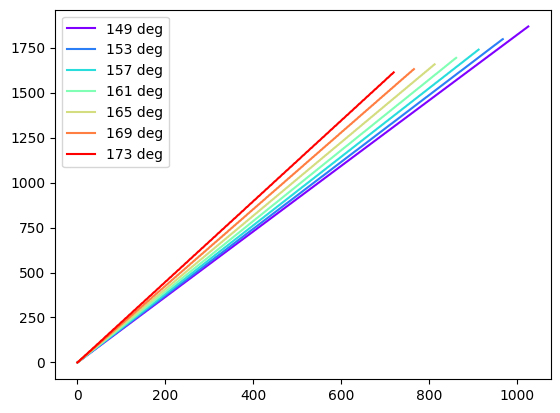

In [191]:
# Double check
import matplotlib.cm as cm

# Generate a list of colors using the 'rainbow' colormap
colors = cm.rainbow(np.linspace(0, 1, len(centered_list)))

plt.figure()
for i, value in enumerate(centered_list):
    plt.plot(distances_dict[f'distances_{value}deg'][0], color=colors[i], label=f'{value} deg')
plt.legend()
plt.show()

In [140]:
for value in centered_list:
    output_obj[f'intensity_{value}deg'].append(np.array(intensity_dict[f'intensity_{value}deg']).T)
    output_obj[f'distances_{value}deg'].append(np.array(distances_dict[f'distances_{value}deg'][0]))

In [207]:
output_obj.keys()

dict_keys(['intensity_149deg', 'distances_149deg', 'intensity_153deg', 'distances_153deg', 'intensity_157deg', 'distances_157deg', 'intensity_161deg', 'distances_161deg', 'intensity_165deg', 'distances_165deg', 'intensity_169deg', 'distances_169deg', 'intensity_173deg', 'distances_173deg', 'time', 'map_obj', 'instrument'])

In [336]:
output_obj['map_obj'][0].rsun_obs.value

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


949.1129337297962

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


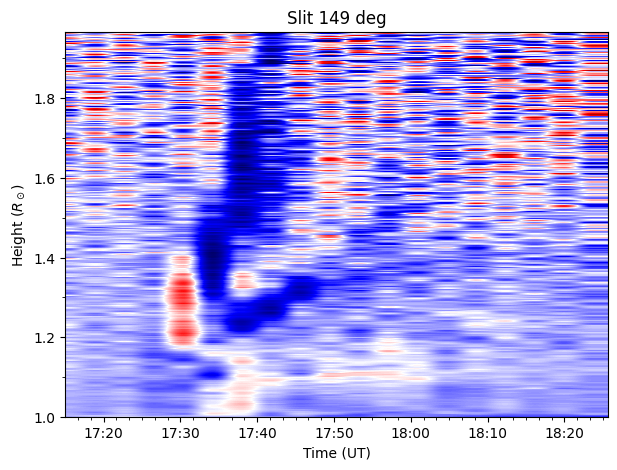

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


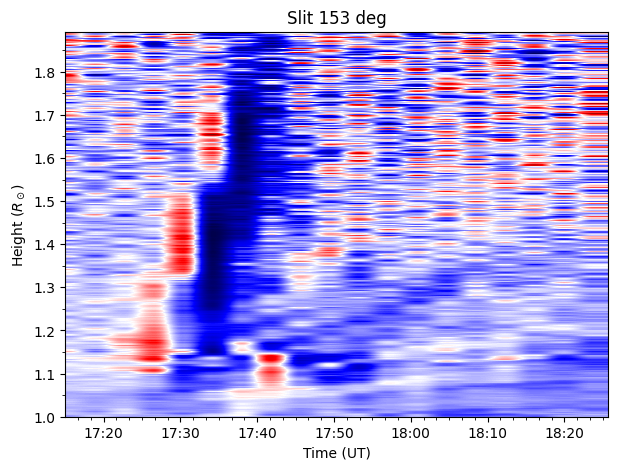

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


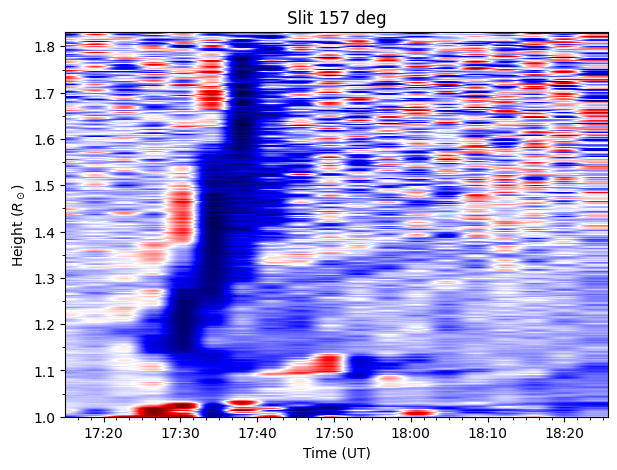

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


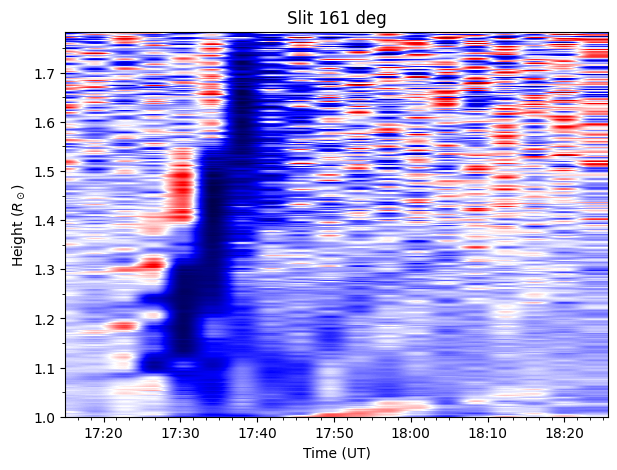

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


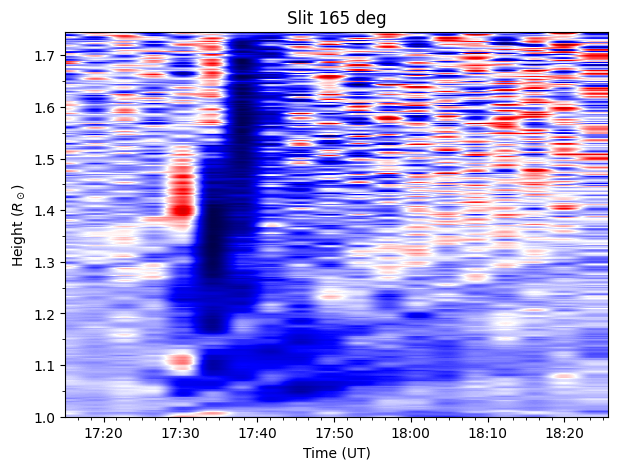

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


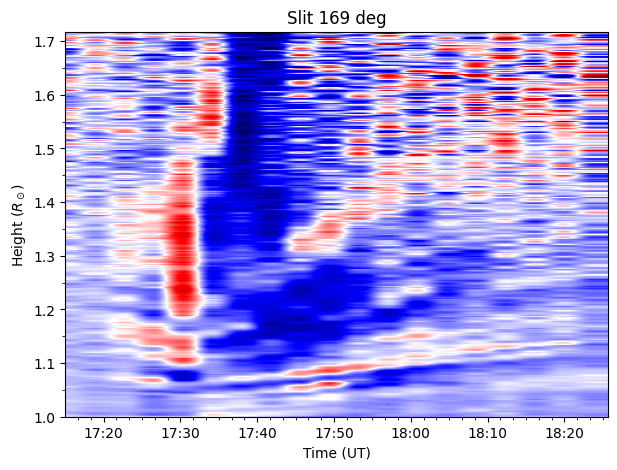

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


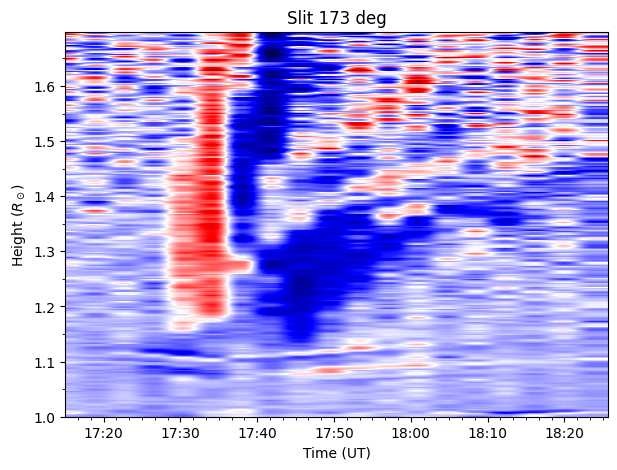

In [205]:
datenum_arr = [mdates.date2num(pd.Timestamp(str(t))) for t in output_obj['time']]

for value in centered_list:
    
    # conversion from arcsec to solar radius
    dist_rsun = output_obj[f'distances_{value}deg'][0] / output_obj['map_obj'][0].rsun_obs.value
    
    fig = plt.figure(figsize=[7,5])

    ax = fig.add_subplot(111)
    ax.imshow(output_obj[f'intensity_{value}deg'][0],
              aspect='auto', origin='lower', cmap='seismic',
            extent=[datenum_arr[0], datenum_arr[-1],
                    dist_rsun[0], dist_rsun[-1]])
    
    ax.set_xlabel('Time (UT)')
    ax.set_ylabel(r'Height ($R_\odot$)')
    ax.set_title(f'Slit {value} deg')
    ax.xaxis_date()
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    ax.xaxis.set_minor_locator(AutoMinorLocator(n=6))
    ax.yaxis.set_minor_locator(AutoMinorLocator(n=2))
    ax.set_ylim(bottom=1)
    ax.set_xlim(left=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:15:00"))
    plt.show()

### Clicking ...

In [209]:
import matplotlib
matplotlib.use('nbAgg')

In [239]:
# Initialize each key with an empty list
feature_coords_slit = {}
for value in centered_list:
    feature_coords_slit[f'x_{value}deg'] = []
    feature_coords_slit[f'y_{value}deg'] = []

In [240]:
# Function to display the figure and handle clicks
def show_figure(angle):
    fig = plt.figure(figsize=[7,5])
    ax = fig.add_subplot(111)
    ax.imshow(output_obj[f'intensity_{angle}deg'][0],
              aspect='auto', origin='lower', cmap='seismic',
              extent=[datenum_arr[0], datenum_arr[-1],
                      output_obj[f'distances_{angle}deg'][0][0],
                      output_obj[f'distances_{angle}deg'][0][-1]])

    for col in datenum_arr:
        ax.axvline(x=col, color='w', linewidth=0.5, linestyle='--')

    ax.set_xlabel('Time (UT)')
    ax.set_ylabel(r'Height ($R_\odot$)')
    ax.set_title(f'Slit {angle} deg')
    ax.xaxis_date()
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    ax.xaxis.set_minor_locator(AutoMinorLocator(n=6))
    ax.yaxis.set_minor_locator(AutoMinorLocator(n=2))
    ax.set_ylim(bottom=round(output_obj['map_obj'][0].rsun_obs.value))
    ax.set_xlim(left=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:20:00"),
                right=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:55:00"))
    
    def onclick(event):
        if event.inaxes == ax:
            if event.button == 1:
                x, y = event.xdata, event.ydata
                feature_coords_slit[f'x_{angle}deg'].append(x)
                feature_coords_slit[f'y_{angle}deg'].append(y)
                ax.plot(x, y, 'ko')
                fig.canvas.draw()
            elif event.button == 3:
                fig.canvas.mpl_disconnect(cid)
                plt.close(fig)  # Close the figure
    
    cid = fig.canvas.mpl_connect('button_press_event', onclick)
    plt.show()

<IPython.core.display.Javascript object>


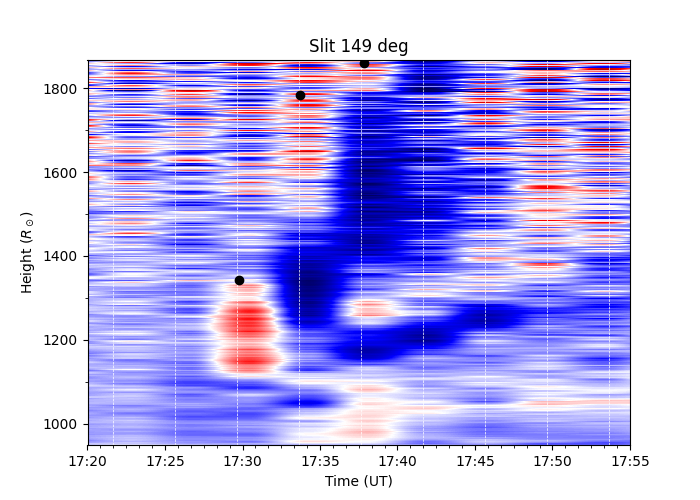

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


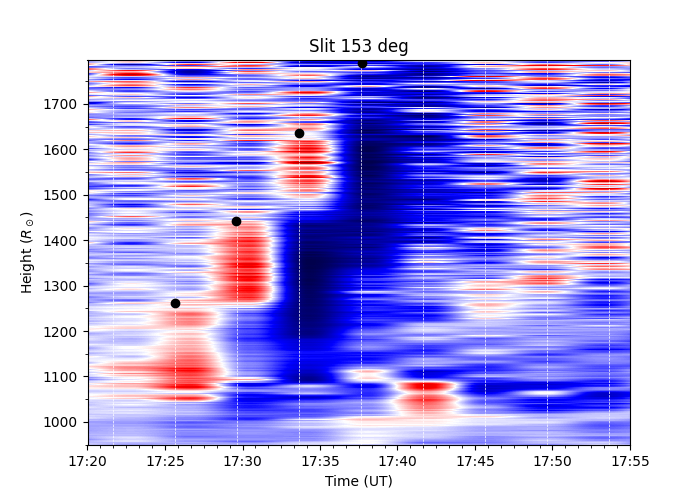

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


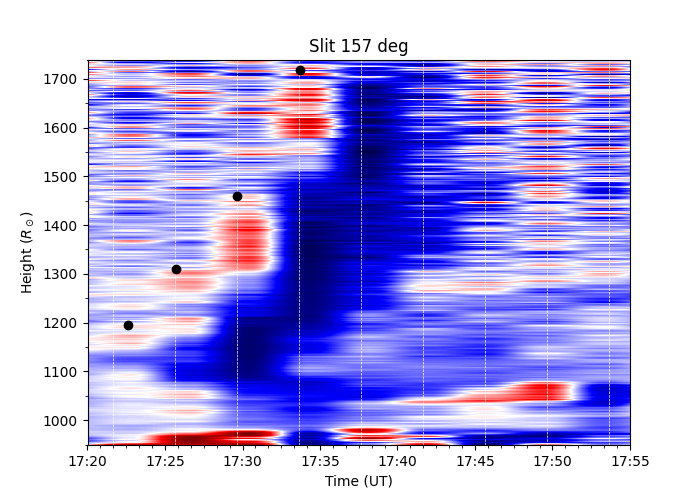

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


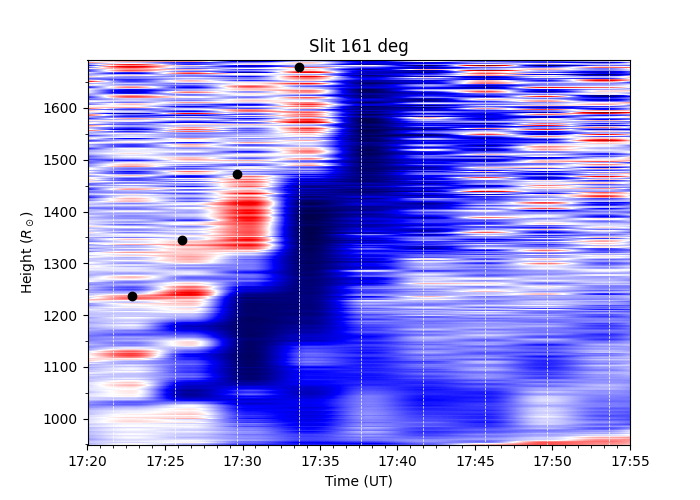

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


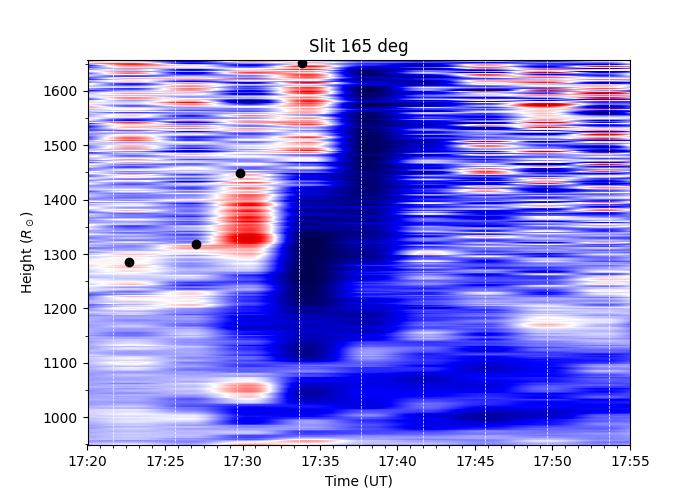

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


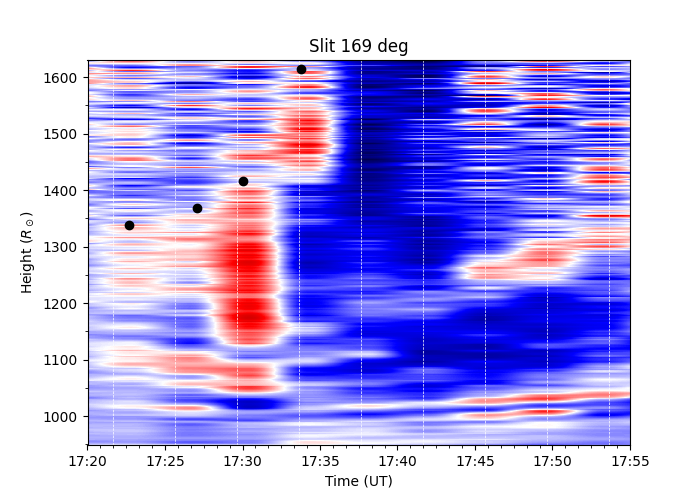

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


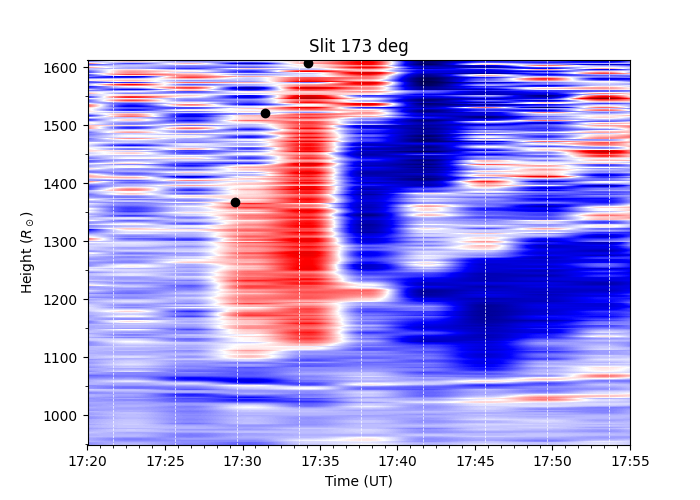

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


In [241]:
# Iterate over each angle and show the figure
for angle in centered_list:
    show_figure(angle)

In [248]:
# Find the maximum length of the arrays in the dictionary
max_length = max(len(coords) for coords in feature_coords_slit.values())

# Pad each array with NaNs to match the maximum length
for key in feature_coords_slit:
    current_length = len(feature_coords_slit[key])
    if current_length < max_length:
        feature_coords_slit[key].extend([np.nan] * (max_length - current_length))

# Convert the dictionary to a DataFrame
df_jplot = pd.DataFrame(feature_coords_slit)

In [249]:
df_jplot

,x_149deg,y_149deg,x_153deg,y_153deg,x_157deg,y_157deg,x_161deg,y_161deg,x_165deg,y_165deg,x_169deg,y_169deg,x_173deg,y_173deg
0,19857.728990,1342.340044,19857.726123,1260.558553,19857.724017,1195.194878,19857.724196,1236.085166,19857.724062,1285.750224,19857.724062,1337.813726,19857.728811,1368.073000
1,19857.731723,1783.524784,19857.728856,1443.310213,19857.726168,1310.026014,19857.726436,1344.255187,19857.727064,1318.839294,19857.727109,1367.892604,19857.730155,1521.363510
2,19857.734591,1859.837820,19857.731678,1637.071010,19857.728901,1459.716601,19857.728901,1471.741282,19857.729035,1449.357293,19857.729169,1415.664939,19857.732082,1607.481773
3,NaN,NaN,19857.734501,1791.198916,19857.731723,1718.086655,19857.731678,1678.423286,19857.731813,1651.568276,19857.731768,1613.831662,NaN,NaN


In [252]:
# Initialize the dictionary to store grouped x and y values
grouped_coords = {}

# Iterate through the DataFrame columns
for col in df_jplot.columns:
    # Extract the angle from the column name (e.g., 'x_149deg' -> '149deg')
    angle = col.split('_')[1]
    
    # Initialize a sub-dictionary for each angle if it doesn't exist
    if angle not in grouped_coords:
        grouped_coords[angle] = {'x': [], 'y': []}
    
    # Append the values to the respective 'x' or 'y' list
    if col.startswith('x_'):
        grouped_coords[angle]['x'] = df_jplot[col].tolist()
    elif col.startswith('y_'):
        grouped_coords[angle]['y'] = df_jplot[col].tolist()

In [256]:
grouped_coords['149deg']

{'x': [19857.728990255375, 19857.73172323029, 19857.7345906138, nan],
 'y': [1342.3400438113808, 1783.5247841227438, 1859.8378202847093, nan]}

In [258]:
times_f, distances = grouped_coords['149deg']['x'], grouped_coords['149deg']['y']

## Fitting the points

In [261]:
%matplotlib inline

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


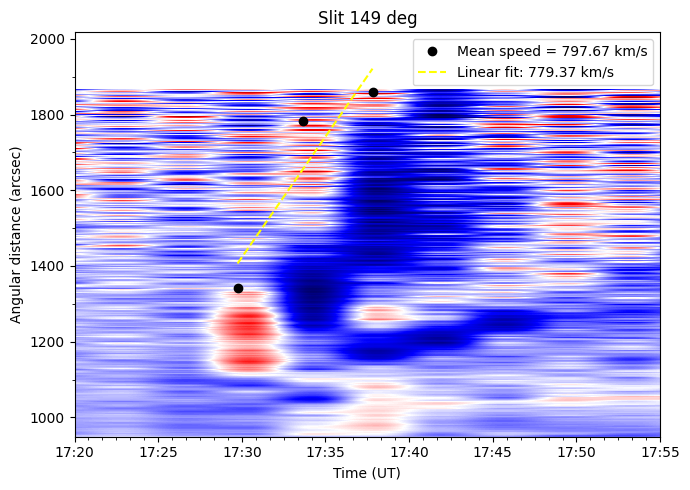

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


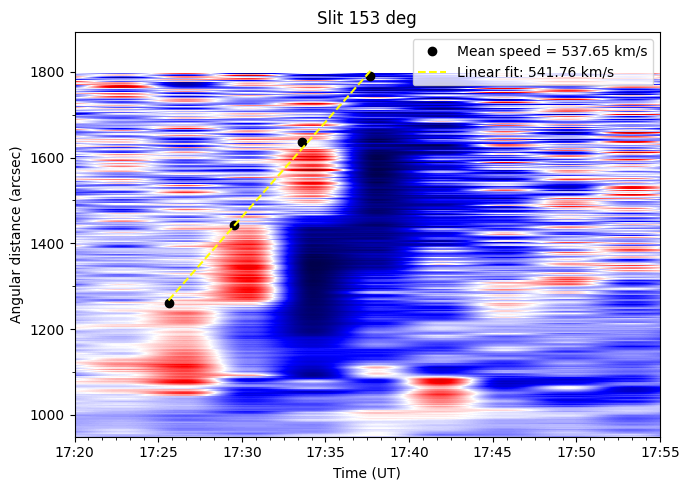

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


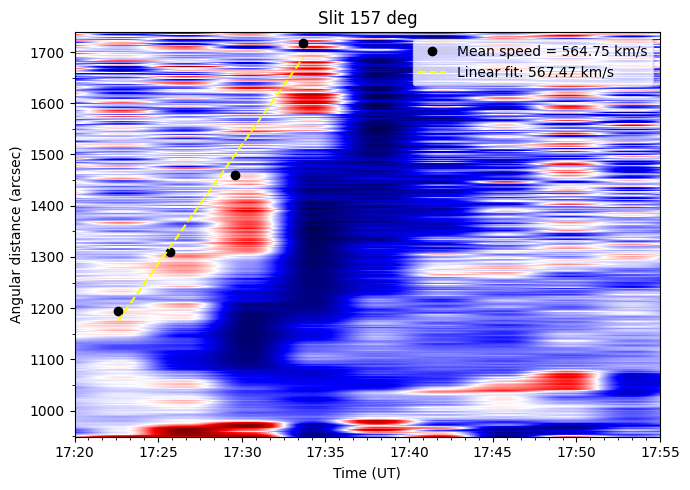

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


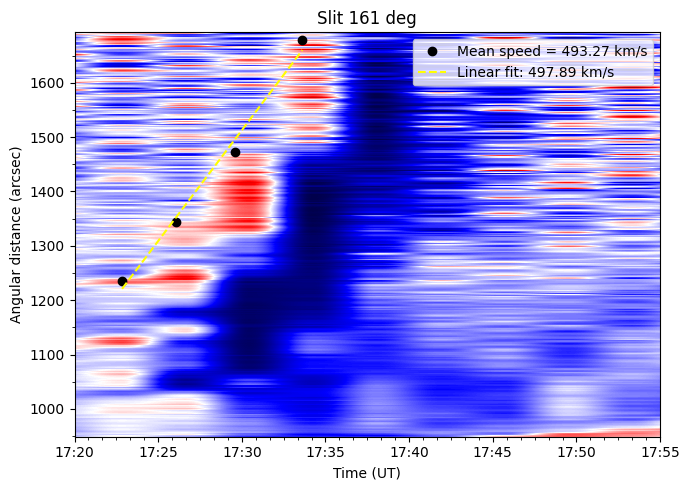

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


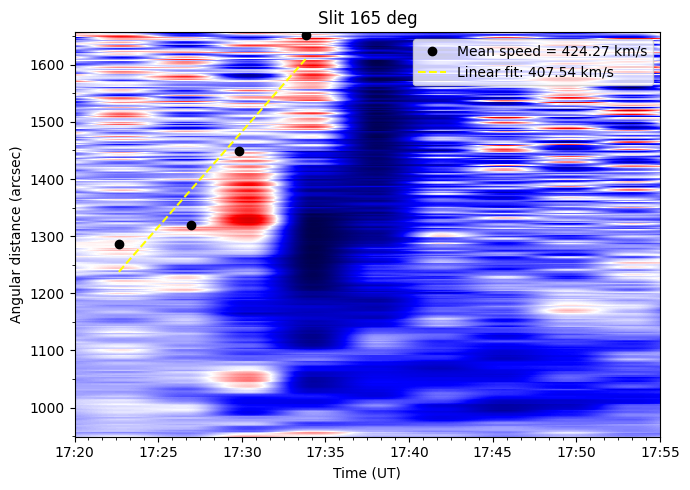

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


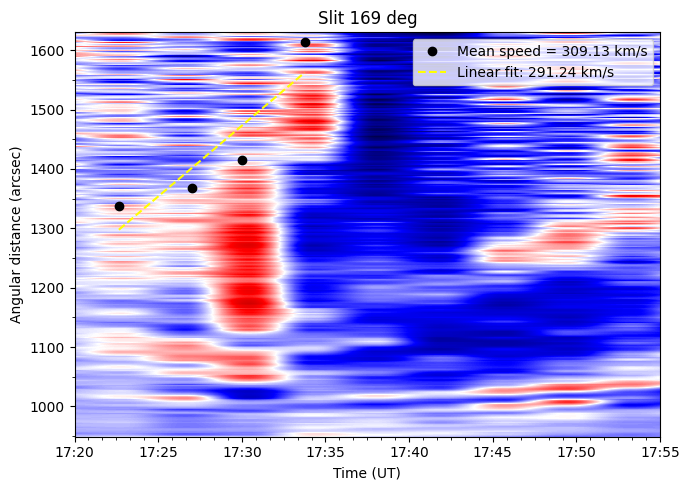

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


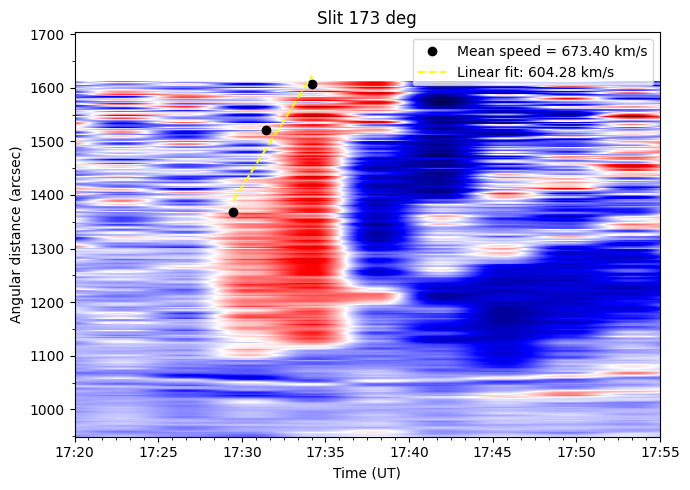

In [332]:
for angle in centered_list:
    
    # Extract time and distance arrays from the selected coordinates
    times_num = pd.DataFrame(grouped_coords[f'{angle}deg']).dropna()['x']
    distances = pd.DataFrame(grouped_coords[f'{angle}deg']).dropna()['y']

    # Perform linear regression to fit a line
    slope, intercept, r_value, p_value, std_err = stats.linregress(times_num, distances)

    # get the radius of the solar disk
    sol_rad = const.equatorial_radius.to(u.km)
    
    # conversion factor from arcsec to km
    conversion_factor = sol_rad/output_obj['map_obj'][0].rsun_obs
    
    # convert distance from arcsec to km
    distance_km = df_jplot[f'y_{angle}deg'] * conversion_factor

    # calculate the distance difference in km
    distance_diff_km = distance_km.diff()

    # convert time to datetime format
    datetime_obj = [mdates.num2date(t) for t in df_jplot[f'x_{angle}deg'] if not pd.isna(t)]

    # Convert the list of datetime objects to a pandas Series
    datetime_series = pd.Series(datetime_obj)

    # calculate the time difference in seconds
    time_diff_s = datetime_series.diff().dt.total_seconds()

    # calculate the speed in km/s
    df_jplot[f'linear_speed_{angle}deg'] = distance_diff_km / time_diff_s

    # drop the first row which will have NaN values for the differences
    # df_jplot.dropna(inplace=True)

    # Calculate spline fit
    try:
        spline = UnivariateSpline(times_num, distances, k=1, s=0)  # s=0 for interpolation through all points

        # Generate the spline line
        spline_times = np.linspace(min(times_num), max(times_num), 1000)
        spline_distances = spline(spline_times)

        # Calculate the derivative of spline_distances with respect to spline_times
        spline_velocity = spline.derivative()(spline_times)

        # Convert velocity (in arcsec/day) to speed in km/s
        # 1 arcsec ≈ 733 km on the Sun's surface
        # 1 day = 86400 seconds
        speed_spline = spline_velocity * conversion_factor.value / 86400  # km/s
        df_jplot[f'spline_speed_{angle}deg'] = speed_spline
        df_jplot[f'spline_times_{angle}deg'] = spline_times
        df_jplot[f'spline_dist_{angle}deg'] = spline_distances
    except:
        print('\nspline fit is not possible')
        pass

    # Calculate the polynomial fit
    try:
        polyfit_coeff = np.polyfit(times_num, distances, 2)  # Fit a 2nd order polynomial
        polyfit_line = np.polyval(polyfit_coeff, spline_times)

        # Calculate the derivative of the polynomial fit (velocity)
        polyfit_velocity = np.polyval(np.polyder(polyfit_coeff), spline_times)
        speed_polyfit = polyfit_velocity * conversion_factor.value / 86400  # km/s
        df_jplot[f'polyfit_dist_{angle}deg'] = polyfit_line
        df_jplot[f'polyfit_speed_{angle}deg'] = speed_polyfit
    except:
        print('polynomial fit is not possible')
        pass
    
    
    # Show the plot with the fit lines
    fig = plt.figure(figsize=[7,5])
    ax = fig.add_subplot(111)
    ax.imshow(output_obj[f'intensity_{angle}deg'][0],
              aspect='auto', origin='lower', cmap='seismic',
              extent=[datenum_arr[0], datenum_arr[-1],
                      output_obj[f'distances_{angle}deg'][0][0],
                      output_obj[f'distances_{angle}deg'][0][-1]])
    
    # Plot the fitted line
    fit_line = slope * np.array(times_num) + intercept
    
    # Calculate the speed (slope in arcsec/day to speed in km/s)
    # 1 arcsec ≈ 733 km on the Sun's surface
    # 1 day = 86400 seconds
    speed_fit = slope * conversion_factor.value/86400  # km/s
    speed = np.nanmean(df_jplot[f'linear_speed_{angle}deg'])

    # Plot the selected points
    ax.plot(times_num, distances, 'ko', label=f'Mean speed = {speed:.2f} km/s')
    ax.plot(times_num, fit_line, ls='--', color='yellow',
            label=f'Linear fit: {speed_fit:.2f} km/s')

    # Plot the spline fit line
    if f'spline_speed_{angle}deg' in df_jplot.columns:
        spline_times = df_jplot[f'spline_times_{angle}deg']
        spline_distances = df_jplot[f'spline_dist_{angle}deg']
        speed_spline = df_jplot[f'spline_speed_{angle}deg']

        ax.plot(spline_times, spline_distances, ls='--', color='tab:red',
                label=f'Spline fit: {np.nanmean(speed_spline):.2f} km/s')

    # Plot the polynomial fit line
    if f'polyfit_speed_{angle}deg' in df_jplot.columns:
        spline_times = df_jplot[f'spline_times_{angle}deg']
        polyfit_distances = df_jplot[f'polyfit_dist_{angle}deg']
        speed_polyfit = df_jplot[f'polyfit_speed_{angle}deg']

        ax.plot(spline_times, polyfit_distances, ls='-', color='tab:blue',
                   label=f'2nd-order Polynomial fit: {np.nanmean(speed_polyfit):.2f} km/s')

    ax.legend()
    ax.set_xlabel('Time (UT)')
    ax.set_ylabel('Angular distance (arcsec)')
    ax.set_title(f'Slit {angle} deg')
    ax.xaxis_date()
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    ax.xaxis.set_minor_locator(AutoMinorLocator(n=6))
    ax.yaxis.set_minor_locator(AutoMinorLocator(n=2))
    ax.set_ylim(bottom=round(output_obj['map_obj'][0].rsun_obs.value))
    ax.set_xlim(left=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:20:00"),
                right=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:55:00"))

    fig.tight_layout()
    plt.show()

In [333]:
df_jplot

,x_149deg,y_149deg,x_153deg,y_153deg,x_157deg,y_157deg,x_161deg,y_161deg,x_165deg,y_165deg,...,x_173deg,y_173deg,speed_km_s_149deg,linear_speed_149deg,linear_speed_153deg,linear_speed_157deg,linear_speed_161deg,linear_speed_165deg,linear_speed_169deg,linear_speed_173deg
0,19857.728990,1342.340044,19857.726123,1260.558553,19857.724017,1195.194878,19857.724196,1236.085166,19857.724062,1285.750224,...,19857.728811,1368.073000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,19857.731723,1783.524784,19857.728856,1443.310213,19857.726168,1310.026014,19857.726436,1344.255187,19857.727064,1318.839294,...,19857.730155,1521.363510,1369.541528,1369.541528,567.304275,453.004984,409.658026,93.517808,83.760117,967.561486
2,19857.734591,1859.837820,19857.731678,1637.071010,19857.728901,1459.716601,19857.728901,1471.741282,19857.729035,1449.357293,...,19857.732082,1607.481773,225.789280,225.789280,582.384651,464.674903,438.919313,561.697241,196.654186,379.237582
3,NaN,NaN,19857.734501,1791.198916,19857.731723,1718.086655,19857.731678,1678.423286,19857.731813,1651.568276,...,NaN,NaN,NaN,NaN,463.260518,776.579973,631.241485,617.586242,646.974696,NaN


In [335]:
# export data points as tables
df_jplot.to_csv('../dias_work/jplot_suvi_CME_no2.csv')

---

## Working with single channel

In [405]:
# Store lists in a dictionary
lists_dict = {
    171: m_seq_runratio_171A,
    195: m_seq_runratio_195A,
    284: m_seq_runratio_284A
}

def get_list_copy(number):
    list_to_copy = lists_dict.get(number)
    if list_to_copy is not None:
        return deepcopy(list_to_copy)
    else:
        return None

In [412]:
channel = 284
final_maps_list = get_list_copy(channel)
cme_number = 2

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


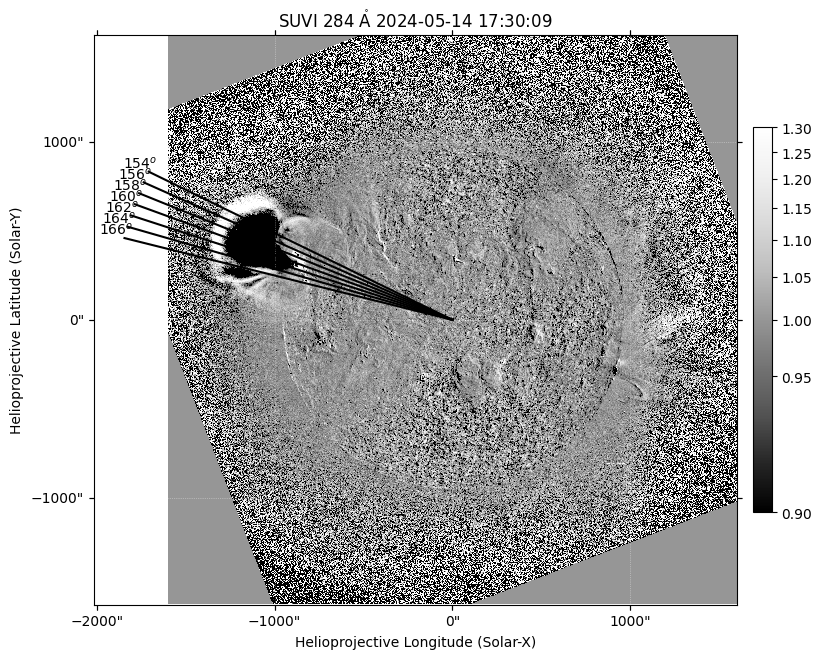

In [413]:
m = deepcopy(final_maps_list[6])

slits = True
norm = ImageNormalize(vmin=0.9, vmax=1.3, stretch=SqrtStretch())

fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111, projection=m)
img = m.plot(axes=ax, cmap='Greys_r', norm=norm)
fig.colorbar(img, shrink=0.5, pad=0.02)

if slits:
    centered_list = generate_centered_list(160, 2, 3)
    for value in centered_list:
        line = plot_line(angle_deg=value, length=1900, map_obj=m)
        ax.plot_coord(line, color='black')
        
        # Plot the number at the end of the line
        # Convert SkyCoord to pixel coordinates for plotting text
        line_lon, line_lat = line.Tx, line.Ty
        end_point_pixel = m.world_to_pixel(SkyCoord(line_lon[1], line_lat[1], frame=m.coordinate_frame))
        
        # Display the number at the end point
        ax.text(end_point_pixel.x.value - 20, end_point_pixel.y.value + 20, f'{value}$^o$',
                color='black', fontsize=10, ha='center', va='center')

plt.show()

Working on map 0 ..


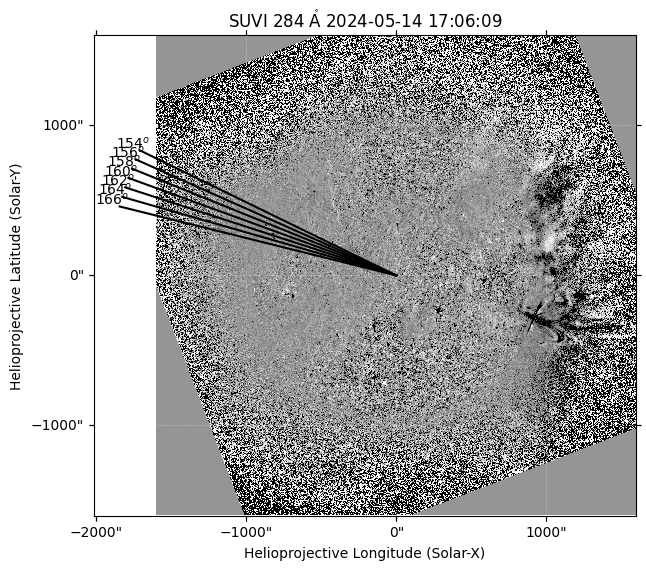

Working on map 1 ..


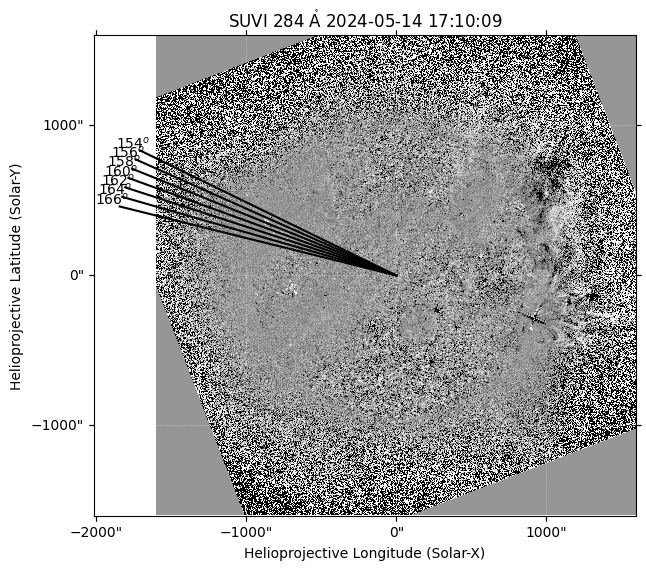

Working on map 2 ..


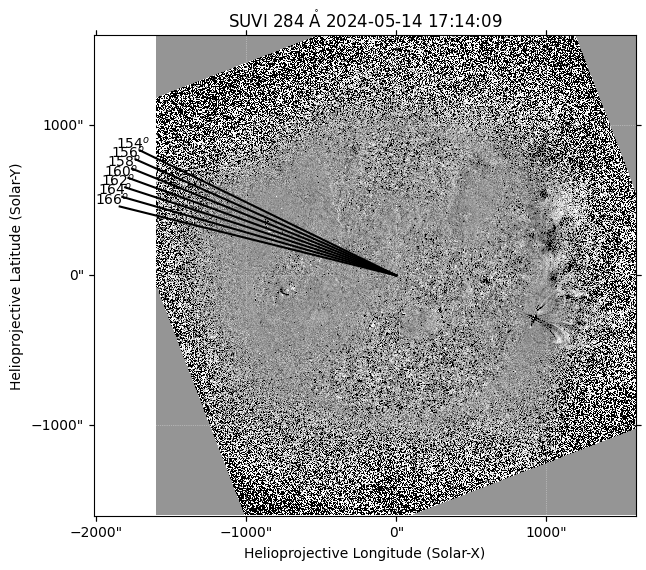

Working on map 3 ..


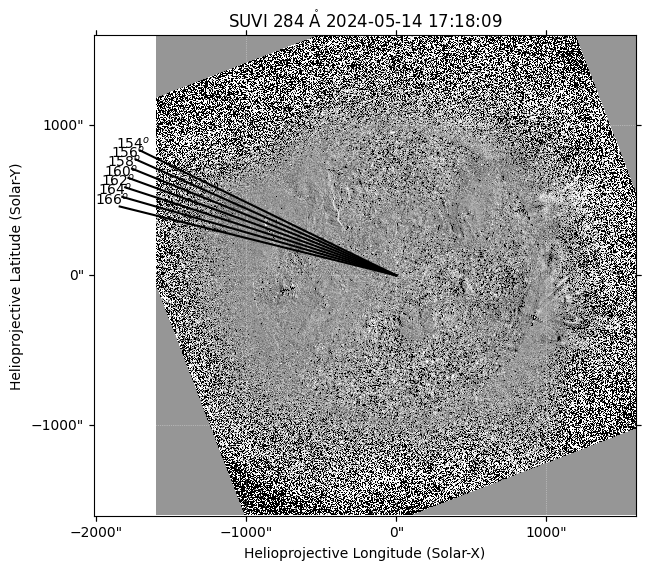

Working on map 4 ..


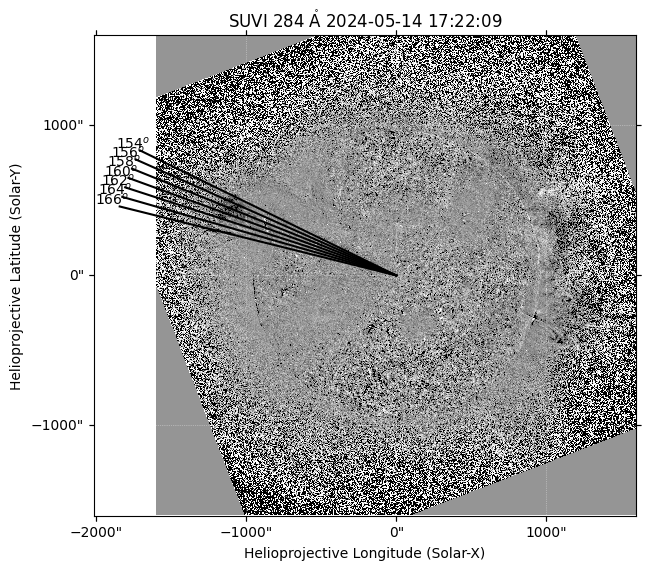

Working on map 5 ..


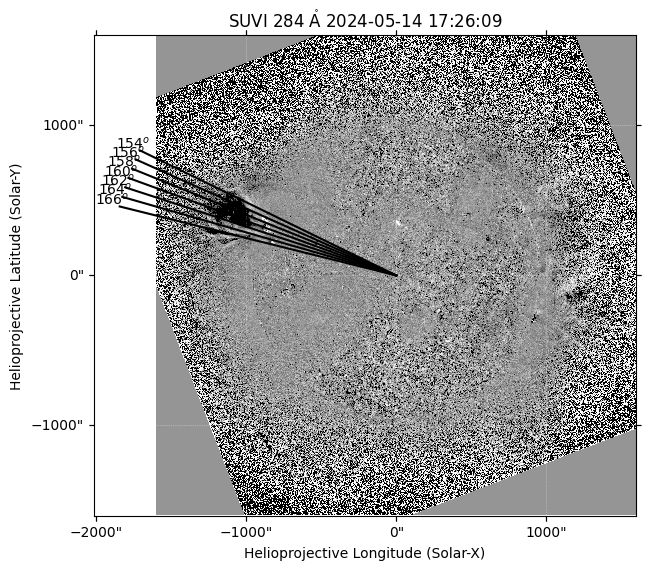

Working on map 6 ..


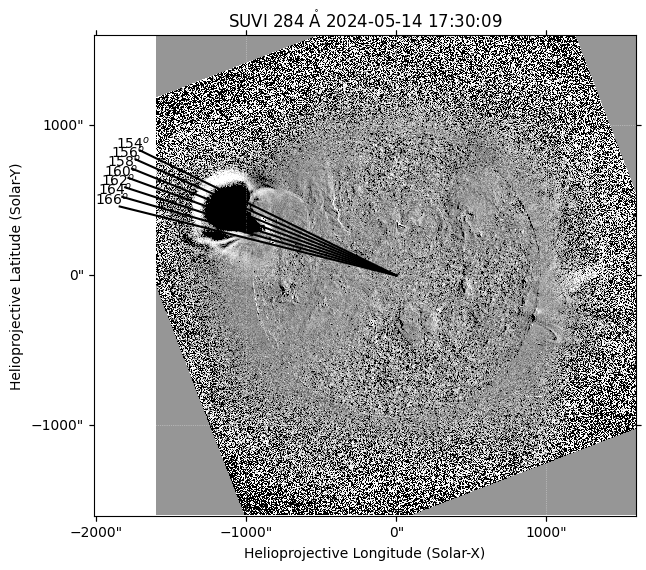

Working on map 7 ..


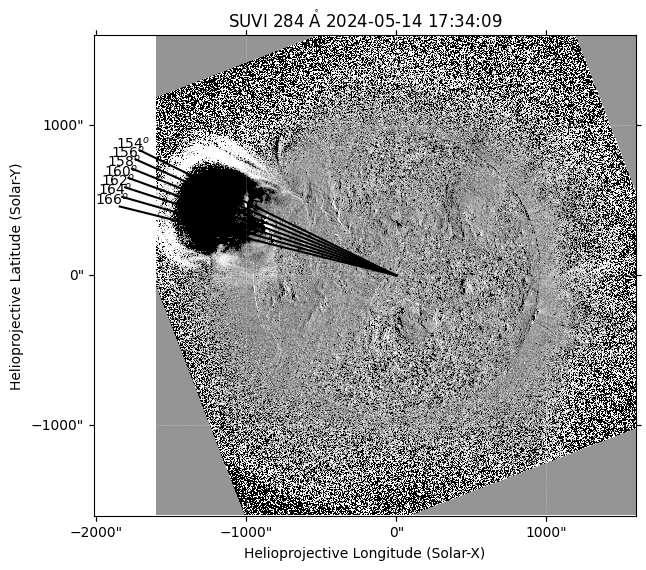

Working on map 8 ..


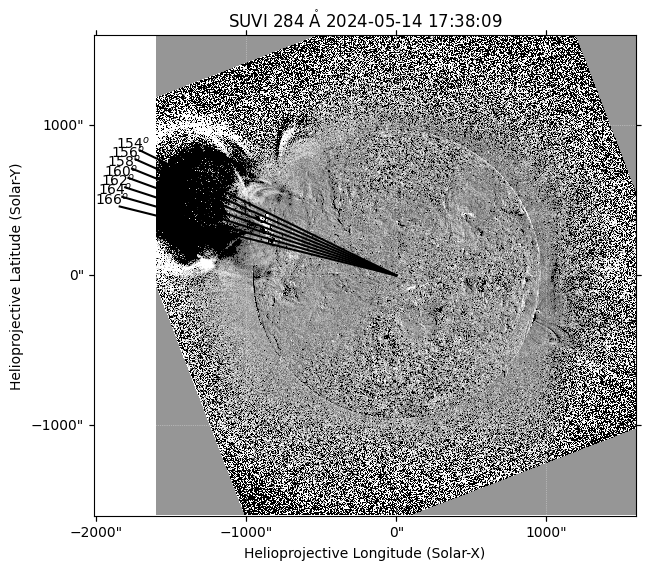

Working on map 9 ..


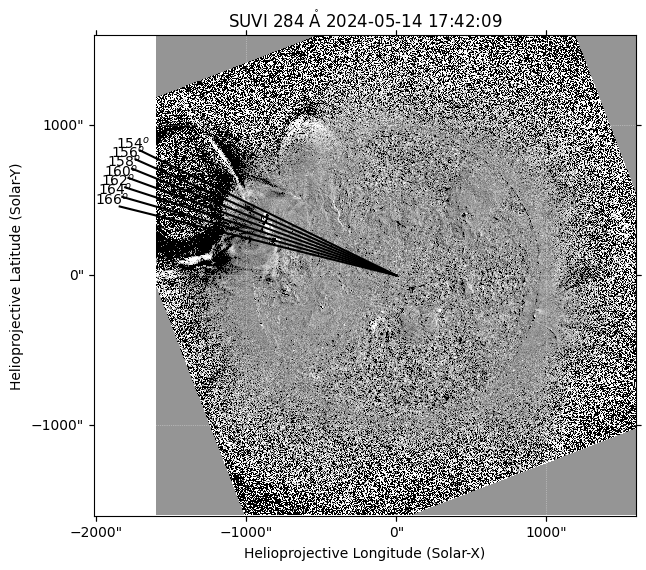

Working on map 10 ..


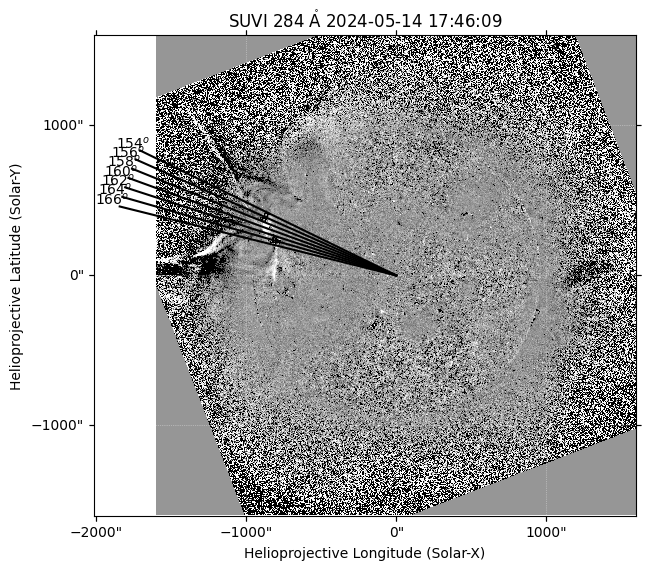

Working on map 11 ..


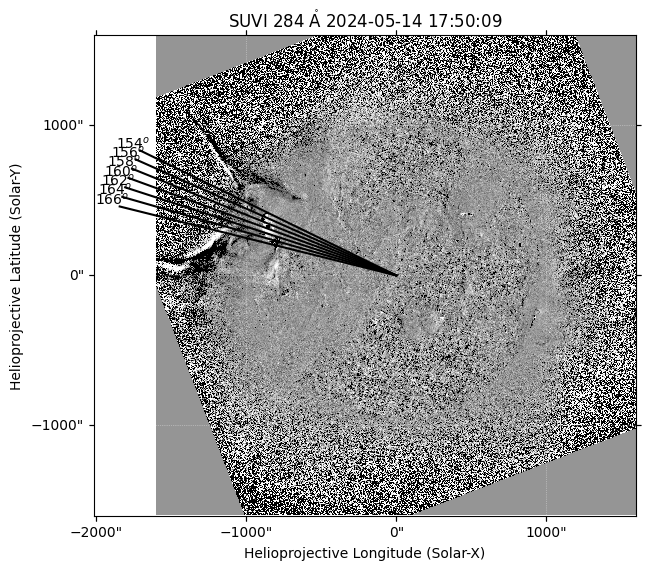

Working on map 12 ..


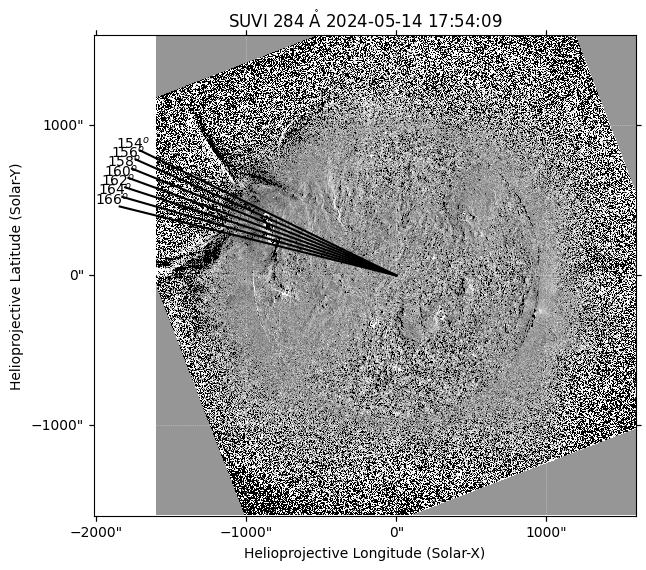

Working on map 13 ..


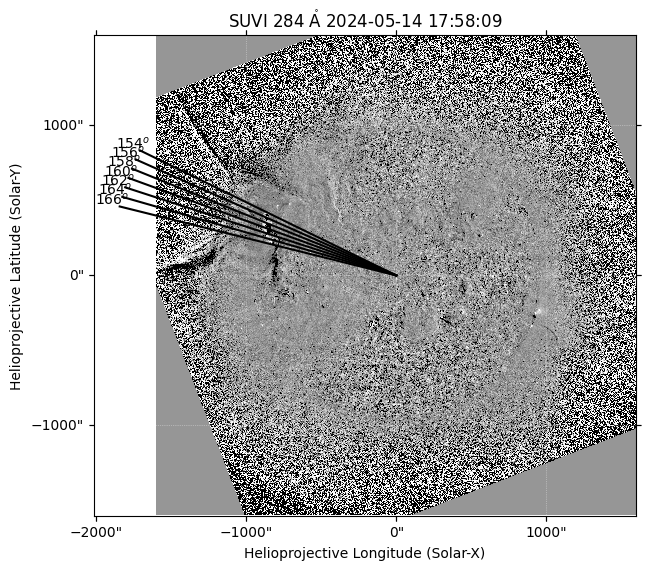

Working on map 14 ..


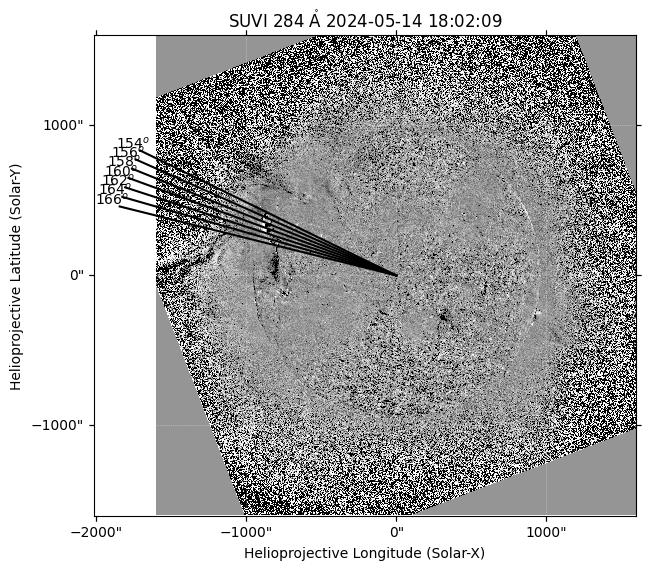

Working on map 15 ..


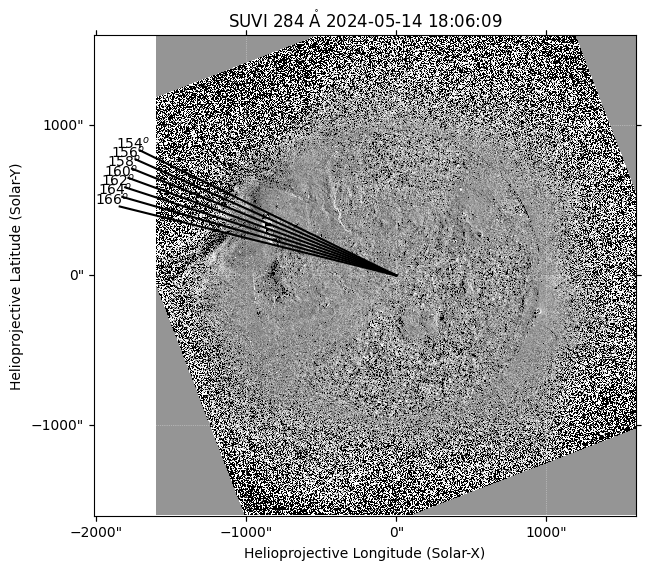

Working on map 16 ..


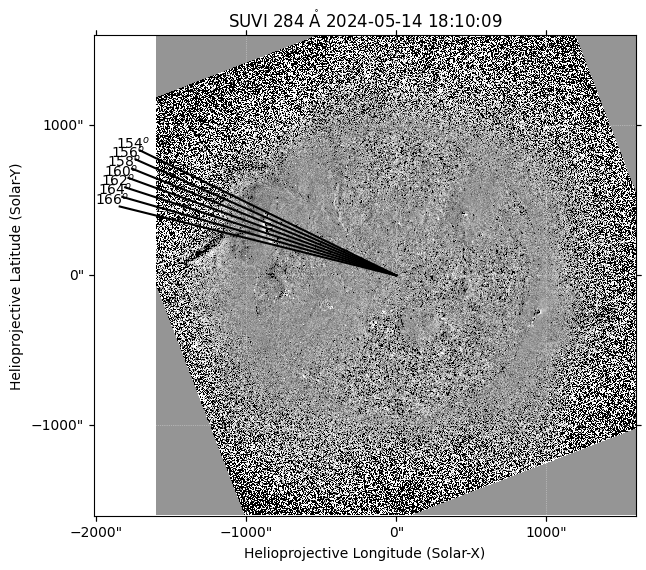

Working on map 17 ..


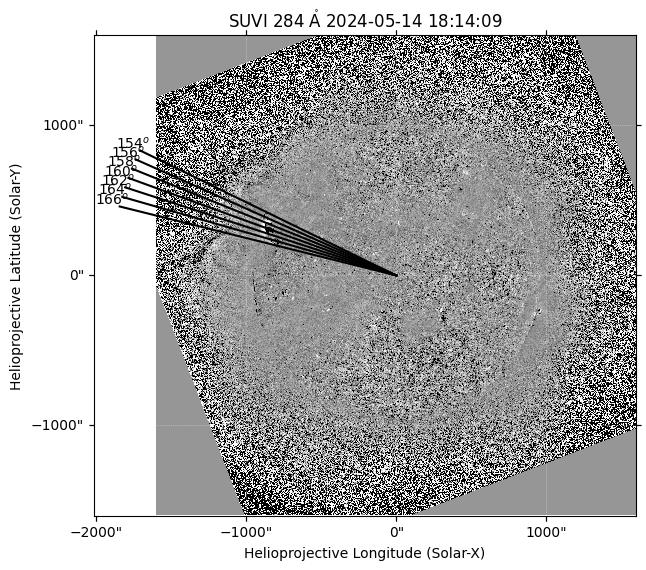

Working on map 18 ..


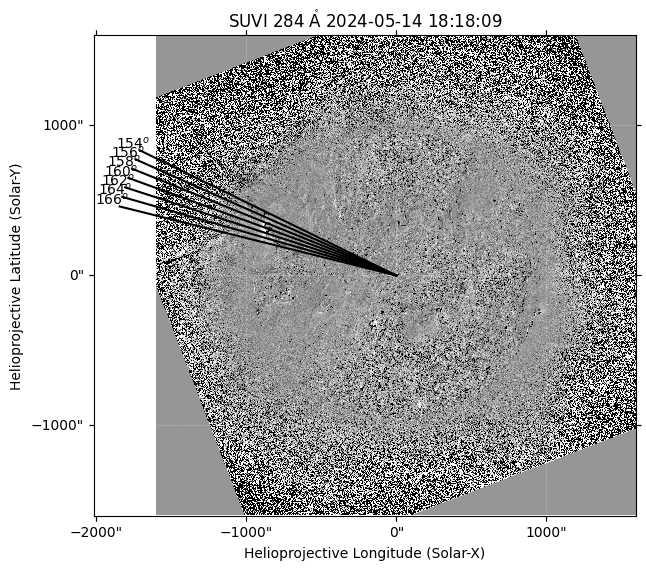

Working on map 19 ..


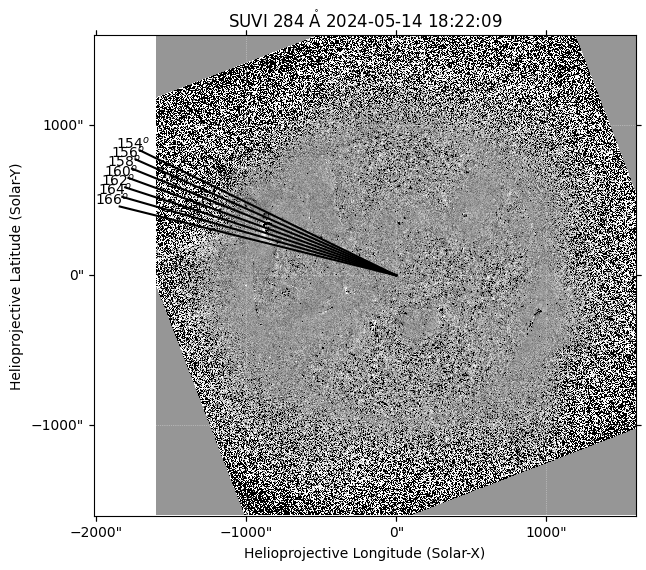

Working on map 20 ..


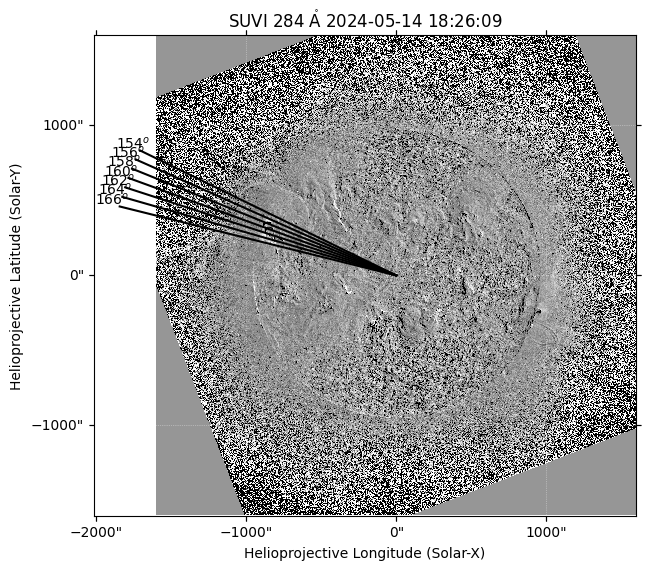

In [422]:
%matplotlib inline

# Make a dictionary to hold the lists of lists
intensity_dict = {}
distances_dict = {}
output_obj = {}

# Initialize each key with an empty list
for value in centered_list:
    intensity_dict[f'intensity_{value}deg'] = []
    distances_dict[f'distances_{value}deg'] = []
    
    output_obj[f'intensity_{value}deg'] = []
    output_obj[f'distances_{value}deg'] = []

output_obj['time'] = []
output_obj['map_obj'] = []
output_obj['instrument'] = []

centered_list = generate_centered_list(160, 2, 3)

for i, m in enumerate(final_maps_list):
    print(f'Working on map {i} ..')
    
    norm = ImageNormalize(vmin=0.9, vmax=1.3, stretch=SqrtStretch())
    
    fig = plt.figure(figsize=[7,7])
    ax = fig.add_subplot(111, projection=m)
    m.plot(axes=ax, cmap='Greys_r', norm=norm)
    
    for value in centered_list:
        line = plot_line(angle_deg=value, length=1900, map_obj=m)
        ax.plot_coord(line, color='black')
        
        # Plot the number at the end of the line
        # Convert SkyCoord to pixel coordinates for plotting text
        line_lon, line_lat = line.Tx, line.Ty
        end_point_pixel = m.world_to_pixel(SkyCoord(line_lon[1], line_lat[1], frame=m.coordinate_frame))
        
        # Display the number at the end point
        ax.text(end_point_pixel.x.value - 20, end_point_pixel.y.value + 20, f'{value}$^o$',
                color='black', fontsize=10, ha='center', va='center')
        
        # obtain the coordinates of the map pixels that intersect that path
        intensity_coords_slit = sunpy.map.pixelate_coord_path(m, line)
        
        # Create mask to identify valid coordinates
        valid_mask = sunpy.map.contains_coordinate(m, intensity_coords_slit)
        
        # Apply the mask to filter valid coordinates
        valid_coords = intensity_coords_slit[valid_mask]
        
        # Pass those coordinates to extract the values for those map pixels
        intensity_slit = sunpy.map.sample_at_coords(m, valid_coords)
        
        # Calculate the angular separation between the first point and every other coordinate we extracted
        angular_separation_slit = valid_coords.separation(valid_coords[0]).to(u.arcsec)
        
        # Append the values to the lists
        intensity_dict[f'intensity_{value}deg'].append(list(intensity_slit.value))
        distances_dict[f'distances_{value}deg'].append(list(angular_separation_slit.value))
    
    output_obj['time'].append(m.date.iso)
    output_obj['map_obj'].append(m)
    output_obj['instrument'].append(m.meta['instrume'])
    
    plt.show()

In [423]:
import matplotlib
matplotlib.use('nbAgg')


for value in centered_list:
    output_obj[f'intensity_{value}deg'].append(np.array(intensity_dict[f'intensity_{value}deg']).T)
    output_obj[f'distances_{value}deg'].append(np.array(distances_dict[f'distances_{value}deg'][0]))

# Initialize each key with an empty list
feature_coords_slit = {}
for value in centered_list:
    feature_coords_slit[f'x_{value}deg'] = []
    feature_coords_slit[f'y_{value}deg'] = []


# Define the start and end timestamps
start_timestamp = pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:06:00")
end_timestamp = pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 18:26:00")

# Generate the list of timestamps with a 1-minute interval
timestamps = pd.date_range(start=start_timestamp, end=end_timestamp, freq='T')
timestamp_list = timestamps.tolist()


# Function to display the figure and handle clicks
def show_figure(angle):
    fig = plt.figure(figsize=[8,5])
    ax = fig.add_subplot(111)
    ax.imshow(output_obj[f'intensity_{angle}deg'][0],
              aspect='auto', origin='lower', cmap='Greys',
#               vmin=-0.5, vmax=2.5,
              vmin=0.5, vmax=1.1,
              extent=[datenum_arr[0], datenum_arr[-1],
                      output_obj[f'distances_{angle}deg'][0][0],
                      output_obj[f'distances_{angle}deg'][0][-1]])

#     for col in timestamp_list:
    for col in datenum_arr:
        ax.axvline(x=col, color='w', linewidth=0.5, linestyle='--', alpha=0.5)

    ax.set_xlabel('Time (UT)')
    ax.set_ylabel('Angular distance (arcsec)')
    ax.set_title(f'Slit {angle} deg')
    ax.xaxis_date()
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    ax.yaxis.set_minor_locator(AutoMinorLocator(n=2))
    ax.set_ylim(bottom=round(output_obj['map_obj'][0].rsun_obs.value))
    ax.set_xlim(left=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:06:00"),
                right=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 18:26:00"))
    
    def onclick(event):
        if event.inaxes == ax:
            if event.button == 1:
                x, y = event.xdata, event.ydata
                feature_coords_slit[f'x_{angle}deg'].append(x)
                feature_coords_slit[f'y_{angle}deg'].append(y)
                ax.plot(x, y, 'rx', markersize=7)
                fig.canvas.draw()
            elif event.button == 3:
                fig.canvas.mpl_disconnect(cid)
                plt.close(fig)  # Close the interaction with the figure
    
    cid = fig.canvas.mpl_connect('button_press_event', onclick)
    plt.show()

<IPython.core.display.Javascript object>


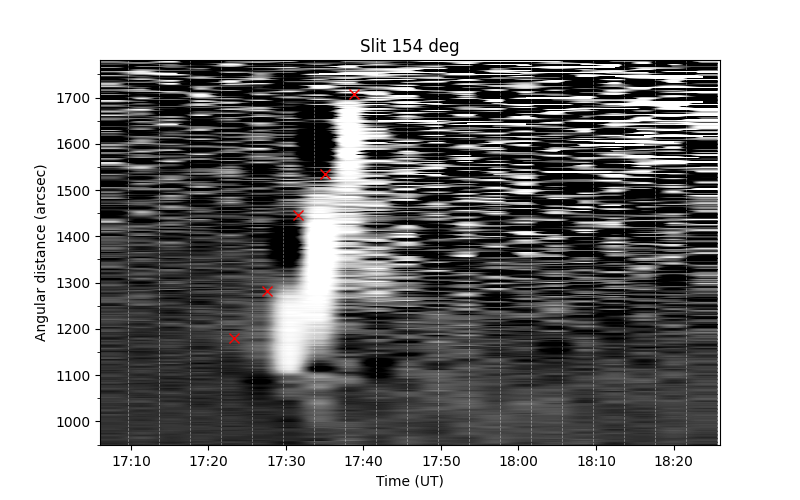

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


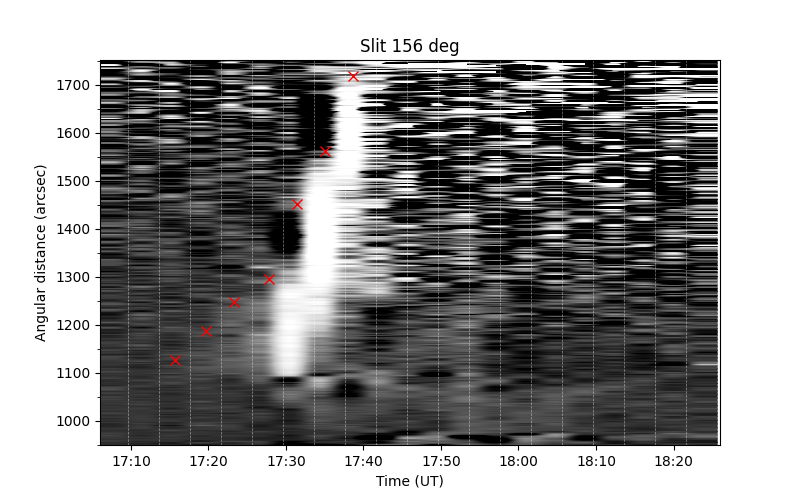

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


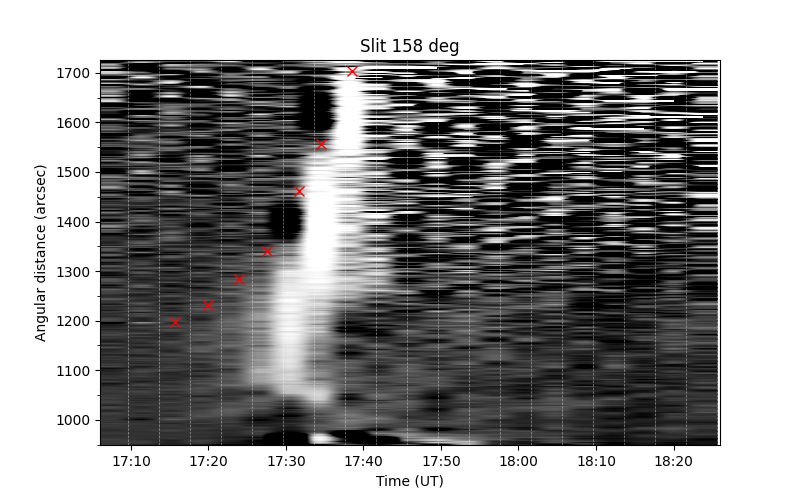

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


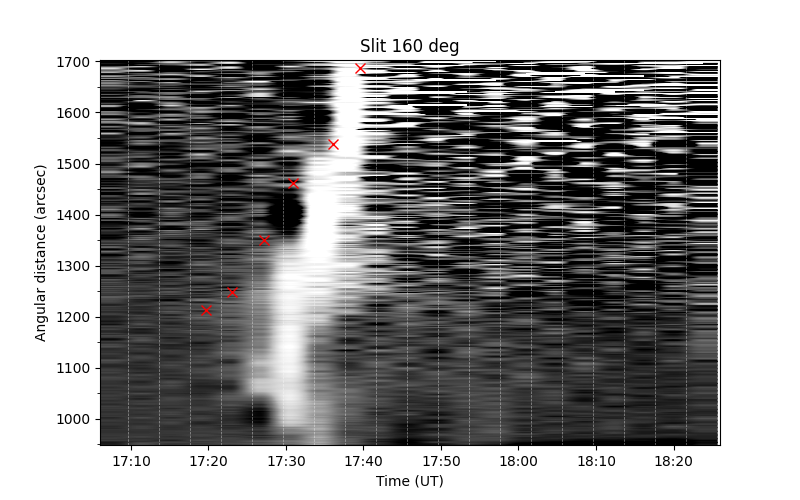

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


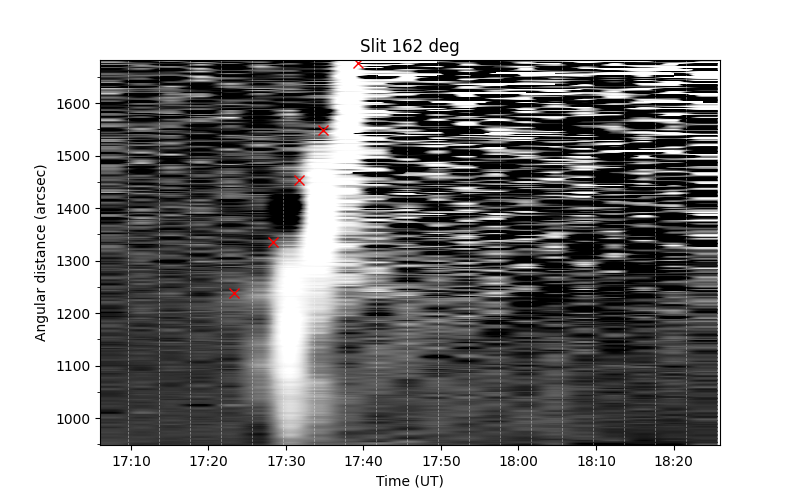

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


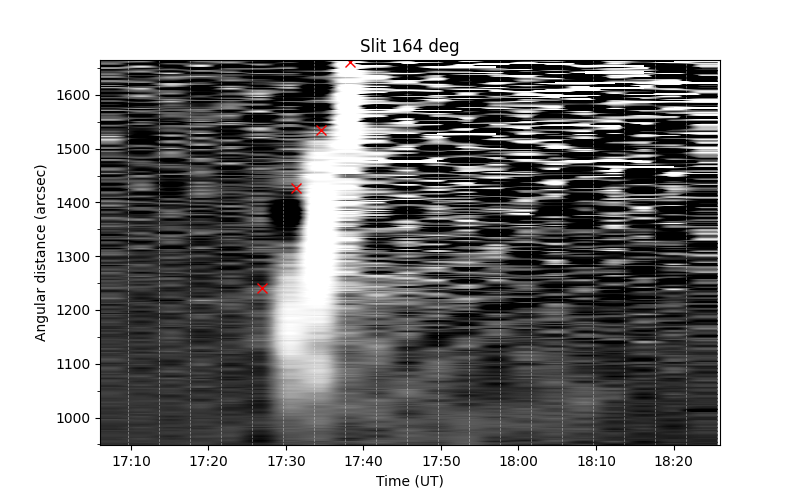

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


<IPython.core.display.Javascript object>


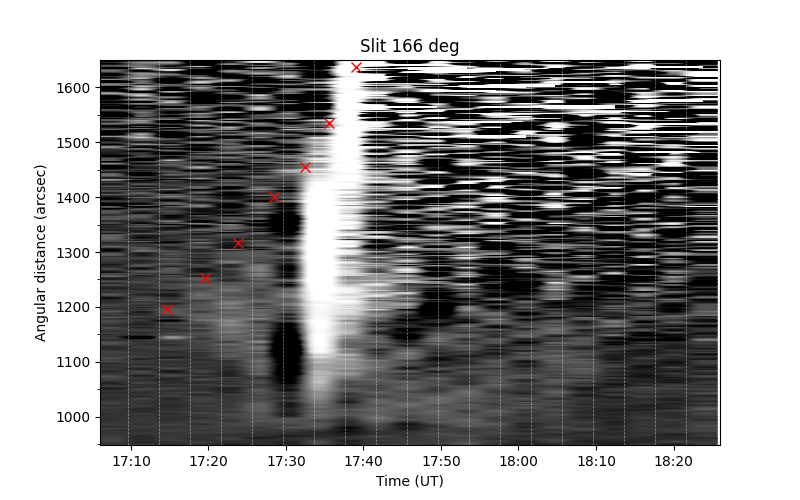

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


In [425]:
# Iterate over each angle and show the figure
for angle in centered_list:
    show_figure(angle)

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


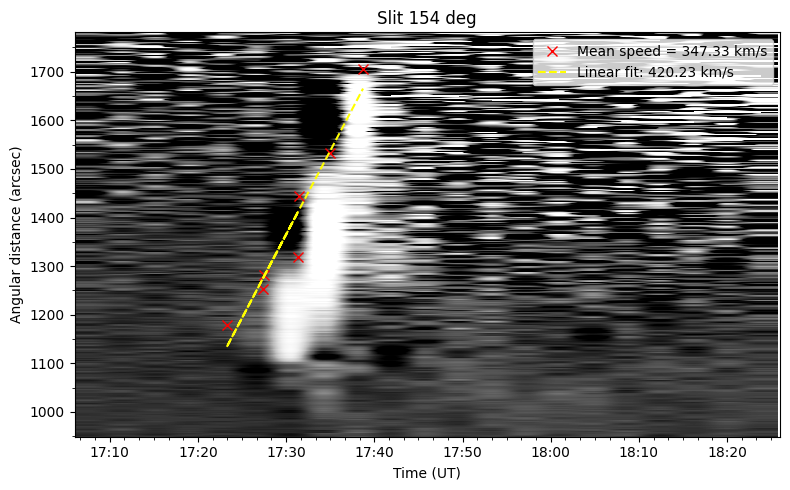

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


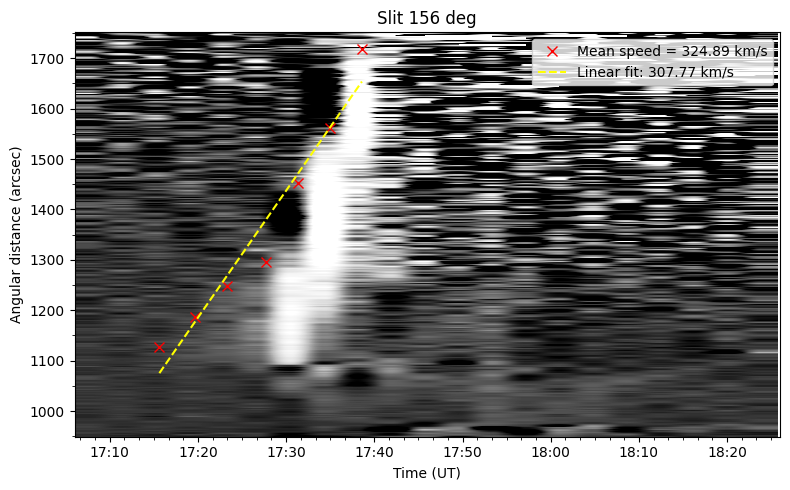

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


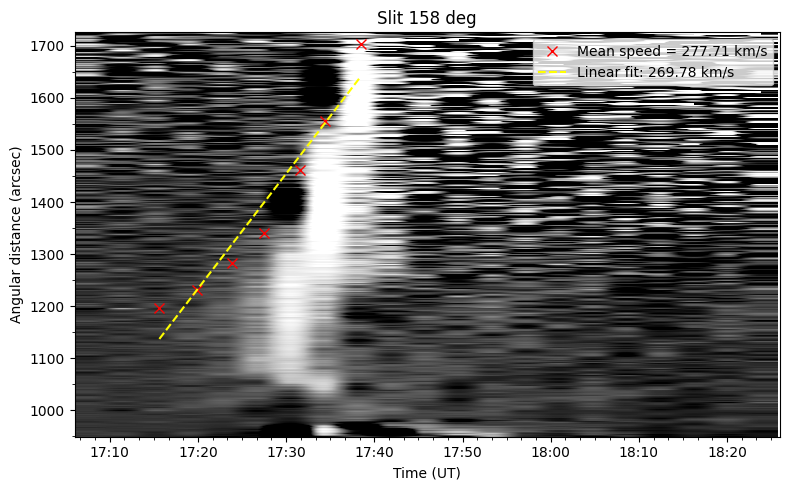

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


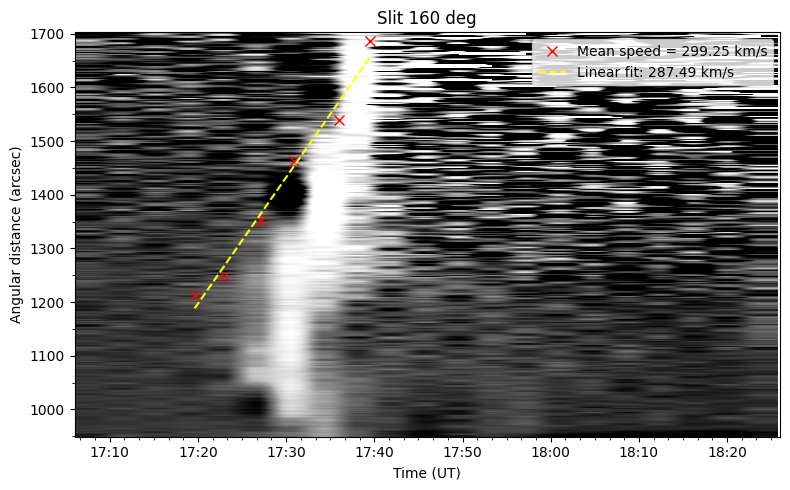

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


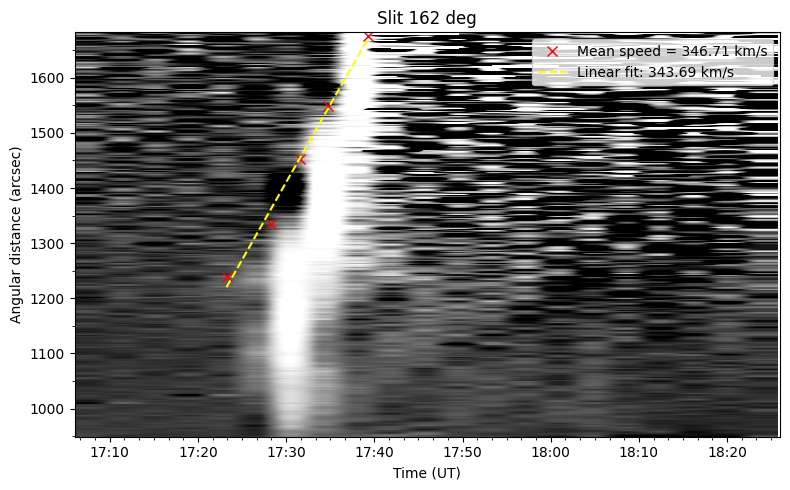

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


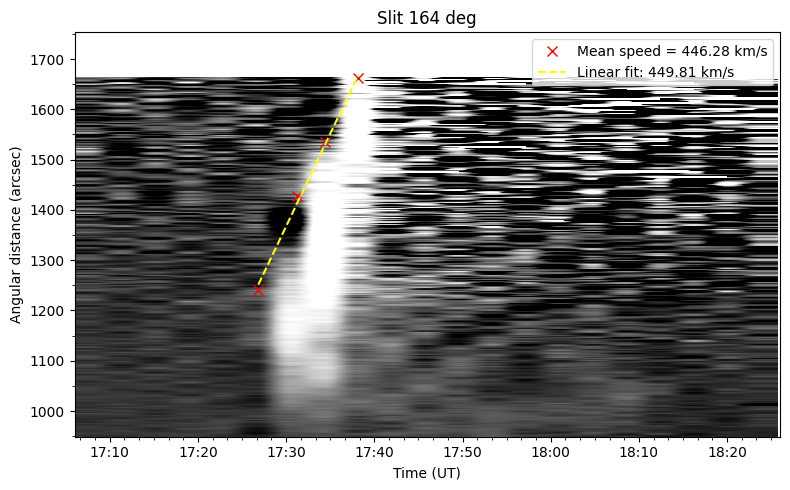

INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.
INFO:sunpy:Missing metadata for solar radius: assuming the standard radius of the photosphere.


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]

spline fit is not possible
polynomial fit is not possible
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


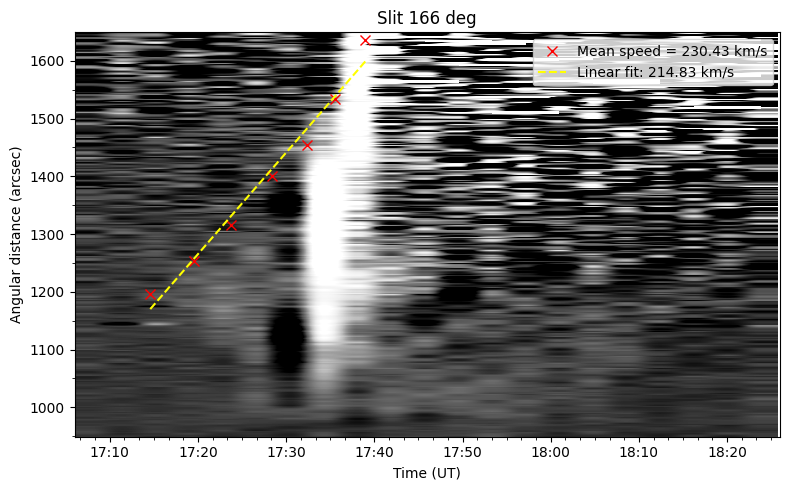

In [426]:
%matplotlib inline


# Find the maximum length of the arrays in the dictionary
max_length = max(len(coords) for coords in feature_coords_slit.values())

# Pad each array with NaNs to match the maximum length
for key in feature_coords_slit:
    current_length = len(feature_coords_slit[key])
    if current_length < max_length:
        feature_coords_slit[key].extend([np.nan] * (max_length - current_length))

# Convert the dictionary to a DataFrame
df_jplot = pd.DataFrame(feature_coords_slit)

# Initialize the dictionary to store grouped x and y values
grouped_coords = {}

# Iterate through the DataFrame columns
for col in df_jplot.columns:
    # Extract the angle from the column name (e.g., 'x_149deg' -> '149deg')
    angle = col.split('_')[1]
    
    # Initialize a sub-dictionary for each angle if it doesn't exist
    if angle not in grouped_coords:
        grouped_coords[angle] = {'x': [], 'y': []}
    
    # Append the values to the respective 'x' or 'y' list
    if col.startswith('x_'):
        grouped_coords[angle]['x'] = df_jplot[col].tolist()
    elif col.startswith('y_'):
        grouped_coords[angle]['y'] = df_jplot[col].tolist()




for angle in centered_list:
    
    # Extract time and distance arrays from the selected coordinates
    times_num = pd.DataFrame(grouped_coords[f'{angle}deg']).dropna()['x']
    distances = pd.DataFrame(grouped_coords[f'{angle}deg']).dropna()['y']
    
    try:
        # Perform linear regression to fit a line
        slope, intercept, r_value, p_value, std_err = stats.linregress(times_num, distances)

        # get the radius of the solar disk
        sol_rad = const.equatorial_radius.to(u.km)

        # conversion factor from arcsec to km
        conversion_factor = sol_rad/output_obj['map_obj'][0].rsun_obs

        # convert distance from arcsec to km
        distance_km = df_jplot[f'y_{angle}deg'] * conversion_factor

        # calculate the distance difference in km
        distance_diff_km = distance_km.diff()

        # convert time to datetime format
        datetime_obj = [mdates.num2date(t) for t in df_jplot[f'x_{angle}deg'] if not pd.isna(t)]

        # Convert the list of datetime objects to a pandas Series
        datetime_series = pd.Series(datetime_obj)

        # calculate the time difference in seconds
        time_diff_s = datetime_series.diff().dt.total_seconds()

        # calculate the speed in km/s
        df_jplot[f'linear_speed_{angle}deg'] = distance_diff_km / time_diff_s
    except:
        print('\nlinear fit is not possible')
        pass

    # Calculate spline fit
    try:
        spline = UnivariateSpline(times_num, distances, k=1, s=0)  # s=0 for interpolation through all points

        # Generate the spline line
        spline_times = np.linspace(min(times_num), max(times_num), 1000)
        spline_distances = spline(spline_times)

        # Calculate the derivative of spline_distances with respect to spline_times
        spline_velocity = spline.derivative()(spline_times)
        
        # Convert velocity (in arcsec/day) to speed in km/s
        # 1 arcsec ≈ 733 km on the Sun's surface
        # 1 day = 86400 seconds
        speed_spline = spline_velocity * conversion_factor.value / 86400  # km/s
        df_jplot[f'spline_speed_{angle}deg'] = speed_spline
        df_jplot[f'spline_times_{angle}deg'] = spline_times
        df_jplot[f'spline_dist_{angle}deg'] = spline_distances
    except:
        print('\nspline fit is not possible')
        pass

    # Calculate the polynomial fit
    try:
        polyfit_coeff = np.polyfit(times_num, distances, 2)  # Fit a 2nd order polynomial
        polyfit_line = np.polyval(polyfit_coeff, spline_times)

        # Calculate the derivative of the polynomial fit (velocity)
        polyfit_velocity = np.polyval(np.polyder(polyfit_coeff), spline_times)
        speed_polyfit = polyfit_velocity * conversion_factor.value / 86400  # km/s
        df_jplot[f'polyfit_dist_{angle}deg'] = polyfit_line
        df_jplot[f'polyfit_speed_{angle}deg'] = speed_polyfit
    except:
        print('polynomial fit is not possible')
        pass
    
    
    # Show the plot with the fit lines
    fig = plt.figure(figsize=[8,5])
    ax = fig.add_subplot(111)
    ax.imshow(output_obj[f'intensity_{angle}deg'][0],
              aspect='auto', origin='lower', cmap='Greys',
              vmin=0.5, vmax=1.1,
              extent=[datenum_arr[0], datenum_arr[-1],
                      output_obj[f'distances_{angle}deg'][0][0],
                      output_obj[f'distances_{angle}deg'][0][-1]])
    
    # Plot the linear fit line
    if f'linear_speed_{angle}deg' in df_jplot.columns:
        fit_line = slope * np.array(times_num) + intercept

        # Calculate the speed (slope in arcsec/day to speed in km/s)
        # 1 arcsec ≈ 733 km on the Sun's surface
        # 1 day = 86400 seconds
        speed_fit = slope * conversion_factor.value/86400  # km/s
        speed = np.nanmean(df_jplot[f'linear_speed_{angle}deg'])

        # Plot the selected points
        ax.plot(times_num, distances, 'rx', markersize=7, label=f'Mean speed = {speed:.2f} km/s')
        ax.plot(times_num, fit_line, ls='--', color='yellow',
                label=f'Linear fit: {speed_fit:.2f} km/s')

    # Plot the spline fit line
    if f'spline_speed_{angle}deg' in df_jplot.columns:
        spline_times = df_jplot[f'spline_times_{angle}deg']
        spline_distances = df_jplot[f'spline_dist_{angle}deg']
        speed_spline = df_jplot[f'spline_speed_{angle}deg']

        ax.plot(spline_times, spline_distances, ls='--', color='tab:red',
                label=f'Spline fit: {np.nanmean(speed_spline):.2f} km/s')

    # Plot the polynomial fit line
    if f'polyfit_speed_{angle}deg' in df_jplot.columns:
        spline_times = df_jplot[f'spline_times_{angle}deg']
        polyfit_distances = df_jplot[f'polyfit_dist_{angle}deg']
        speed_polyfit = df_jplot[f'polyfit_speed_{angle}deg']

        ax.plot(spline_times, polyfit_distances, ls='-', color='tab:blue',
                   label=f'2nd-order Polynomial fit: {np.nanmean(speed_polyfit):.2f} km/s')

    ax.legend()
    ax.set_xlabel('Time (UT)')
    ax.set_ylabel('Angular distance (arcsec)')
    ax.set_title(f'Slit {angle} deg')
    ax.xaxis_date()
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    ax.xaxis.set_minor_locator(AutoMinorLocator(n=6))
    ax.yaxis.set_minor_locator(AutoMinorLocator(n=2))
    ax.set_ylim(bottom=round(output_obj['map_obj'][0].rsun_obs.value))
    ax.set_xlim(left=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 17:06:00"),
                right=pd.Timestamp(f"{output_obj['time'][0].split(' ')[0]} 18:26:00"))
    
    fig.tight_layout()
    plt.show()


# export data points as tables
df_jplot.to_csv(f'../dias_work/jplot_suvi_{channel}_CME_No{cme_number}.csv')

In [417]:
1

1